# Linear Models in Machine Learning on Python - Logistic Regression 4

Welcome to the last notebook about Logistic Regression. In the last notebook on Logistic Regression I will do two examples, one for binary classification and the other one is for multiclass classification. In the binary classification example, I will use the weather dataset that we used in the second notebook, but this time I will try to deal with class imbalance, by extension of that, I will try to improve the performance. In the second example, I will use a new dataset and introduce some new cross validation functions.

## Binary Classification with Logistic Regression

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.impute import SimpleImputer
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.base import clone
import warnings
from sklearn.preprocessing import LabelEncoder
warnings.filterwarnings('ignore', module='sklearn')
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import cross_validate
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from matplotlib import pyplot
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc

Let's load our dataset.

In [2]:
data=pd.read_csv("weatherAUS.csv")
data.head(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


I will define the function that I utilized in the second notebook and then transform the data.

In [3]:
def splitdate(data_s):
    data_s["Date"] = pd.to_datetime(data_s["Date"]) #convert it to date
    data_s["Year"]=data_s["Date"].dt.year # Parsing year 
    data_s["Month"]=data_s["Date"].dt.month # Parsing month
    data_s["Day"]=data_s["Date"].dt.day # Parsing day
    data_s =  data_s.drop(["Date"], axis=1) # Dropping original Date row
    return data_s;

In [4]:
from sklearn.base import BaseEstimator, TransformerMixin

class Convert_Missing(BaseEstimator, TransformerMixin):
    def __init__(self,data): # no *args or **kargs
        print("Transforming in progress...")
        self.data=data;
        self.splitted_data=splitdate(data);
        self.categorical = [features for features in self.splitted_data.columns if self.splitted_data[features].dtype==object]
        self.numerical = [features for features in self.splitted_data.columns if self.splitted_data[features].dtype==float]
        self.numerical_int64 = [features for features in self.splitted_data.columns if self.splitted_data[features].dtype=='int64']
    def transform(self):
        imputer = SimpleImputer(strategy="most_frequent")
        features_categorical=imputer.fit_transform(self.splitted_data[self.categorical])
        imputer = SimpleImputer(strategy="median")
        features_numeric=imputer.fit_transform(self.splitted_data[self.numerical])
        concatenated_array=np.concatenate((features_categorical,features_numeric),axis=1)#concatane arrays obtained from imputer
        dataframe=pd.DataFrame(concatenated_array, columns=self.categorical+self.numerical) # convert it to dataframe
        frames = [dataframe, data[self.numerical_int64]] # combining the dataframe in the previous line and date dataframe 
        final_dataframe=pd.concat(frames,axis=1)  # concataneting the two dataframes in the previous line
        final_dataframe=final_dataframe.loc[:,~final_dataframe.columns.duplicated()]
        print("Transforming completed")
        return final_dataframe

In [5]:
le=LabelEncoder()
def One_Hot_Encoder(data):
    numerical = [features for features in data.columns if data[features].dtype==float]  # getting names of numerical columns
    categorical = [features for features in data.columns if data[features].dtype==object] # getting names of categorical columns
    numerical_int64 = [features for features in data.columns if data[features].dtype=='int64']
    data=pd.concat([data[numerical],data[categorical],data[numerical_int64],pd.get_dummies(data.Location), 
                     pd.get_dummies(data.WindGustDir),
                     pd.get_dummies(data.WindDir9am),
                     pd.get_dummies(data.WindDir3pm)],axis=1)
    data["RainToday"]=le.fit_transform(data["RainToday"])
    data.drop(['Location','WindGustDir','WindDir9am','WindDir3pm'],axis=1,inplace=True)
    return data;

In [6]:
def scaleandmerge(data):
    
    scaler = StandardScaler()
    numerical_data = scaler.fit_transform(data[numerical])
    numerical_data = pd.DataFrame(numerical_data, columns=[numerical])
    data.drop(numerical,axis=1,inplace=True)
    data_processed=pd.concat([numerical_data, data],axis=1) 
    return data_processed

In [7]:
def combinedprocessing(data):
    missing_transformer=Convert_Missing(data)
    data1=missing_transformer.transform()
    data2=One_Hot_Encoder(data1)
    data3=scaleandmerge(data2)
    return data3;

In [8]:
numerical = [features for features in data.columns if data[features].dtype==float]
data_processed=combinedprocessing(data)

Transforming in progress...
Transforming completed


There is one important processing step that we need to do. When we are applying OneHotEncoding we also create some columns with the same name. This is not actually because of OneHotEncoding but because of the features that we encode have common values. For example let's look at the feature ******. If you look at 

In [9]:
def df_column_uniquify(df):
    df_columns = df.columns
    new_columns = []
    for item in df_columns:
        counter = 0
        newitem = item
        while newitem in new_columns:
            counter += 1
            newitem = "{}_{}".format(item, counter)
        new_columns.append(newitem)
    df.columns = new_columns
    return df

In [10]:
data_processed=df_column_uniquify(data_processed)

Now let's use train_test_split() function on processed data and encode our target feature with LabelEncoder().

In [11]:
from sklearn.model_selection import train_test_split
le=LabelEncoder()
target=le.fit_transform(data_processed["RainTomorrow"])
data_processed.drop(["RainTomorrow"],axis=1,inplace=True)

X_train, X_test, y_train, y_test = train_test_split(data_processed, target, test_size = 0.2, random_state = 42)

## Dealing with Class Imbalance

We are done with transforming the data, now let's again look at the class imbalance in our target feature.

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

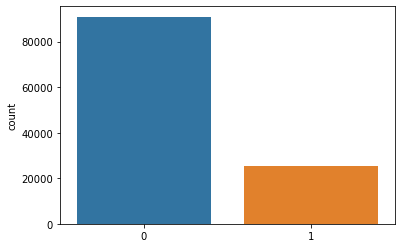

In [12]:
sns.countplot(y_train)

In this part I will talk about one of the ways to deal with class imbalance, resampling. There are other ways and we actually used some of them before(such as adding class weight to classifier). However, resampling is a more general step for dealing with class imbalance compared to other methods that we used previously. If you would like to learn more about other ways to deal with class imbalance you can use check the [link](https://machinelearningmastery.com/tactics-to-combat-imbalanced-classes-in-your-machine-learning-dataset/) 

 
In order to deal with class imbalance we can resample our dataset in two ways, we can either remove samples from the majority class (that is called undersampling) or we can add more examples from the minority class (that is called oversampling). There are different algorithms to oversample or undersample. In this part I will talk about some of them and train a model to select which of these techniques works best for our dataset. In the end I will share a depository that you can find more about these techniques and other techniques that you can use to resample. On the other hand, before starting, I would like to share an article about Statistical Sampling. It's an important concept to learn I think so that one can understand the importance of stratifiedsampling and sampling error, this article will be a good introduction for you [link](https://machinelearningmastery.com/statistical-sampling-and-resampling/)

### Random Undersampling

The first approach that I will use for resampling is Random Undersampling. As name suggests, we will randomly select some instances from the dataset and then delete them.

In [13]:
from imblearn.under_sampling import RandomUnderSampler

In [14]:
undersampler = RandomUnderSampler(sampling_strategy='majority',random_state=42)

One important parameter that we will use for resampling functions is **sampling_strategy**. When we pass majority, it means that we want to reduce the majority class to the size of minority class.

In [15]:
undersampler_float = RandomUnderSampler(sampling_strategy=0.7,random_state=42)

We can also set the sampling_strategy to a floating point value. In this case we are actually setting a percantage. For example, setting the argument to 0.3 will cause our our majority class to have %30 more instances than the minority class.

In [16]:
X_rusmajority,yrusmajority = undersampler.fit_resample(X_train,y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

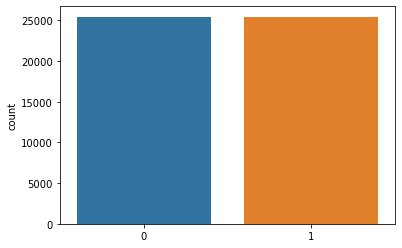

In [17]:
sns.countplot(yrusmajority)

Let's also use the second RandomUnderSampler() that we defined.

In [18]:
X_rusfloat, yrusfloat = undersampler_float.fit_resample(X_train,y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

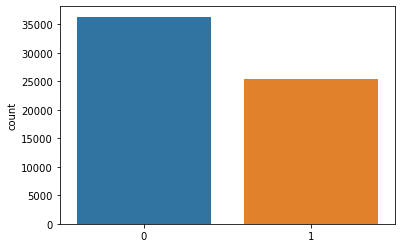

In [19]:
sns.countplot(yrusfloat)

You probably noticed that I only resample the training set. To understand why, read the discussion [link](https://datascience.stackexchange.com/questions/57882/resampling-for-imbalaced-datasets-should-testing-set-also-be-resampled)

### Random Oversampling

I will do almost the exact same steps that I did above, with a little difference. This time I will set sampling_strategy to minority since we are randomly oversampling (copying random instances) the minority class.

In [20]:
from imblearn.over_sampling import RandomOverSampler

In [21]:
oversampler = RandomOverSampler(sampling_strategy='minority',random_state=42)

In [22]:
oversampler_float = RandomOverSampler(sampling_strategy=0.4,random_state=42)

In [23]:
X_rosmajority,yrosmajority = oversampler.fit_resample(X_train,y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

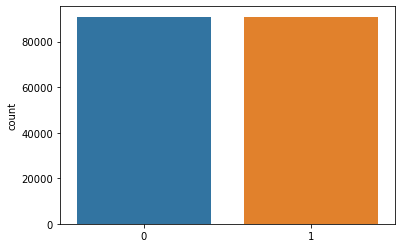

In [24]:
sns.countplot(yrosmajority)

In [25]:
X_rosfloat, yrosfloat = oversampler_float.fit_resample(X_train,y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

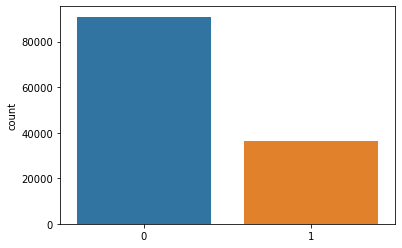

In [26]:
sns.countplot(yrosfloat)

Documentation for `RandomOverSampler()` [link](https://imbalanced-learn.org/stable/references/generated/imblearn.over_sampling.RandomOverSampler.html)


Documentation for `RandomUnderSampler()` [link](https://imbalanced-learn.org/stable/references/generated/imblearn.under_sampling.RandomUnderSampler.html)

Also I do recommend reading this article on machine learning mastery [link](https://machinelearningmastery.com/combine-oversampling-and-undersampling-for-imbalanced-classification/)

### Synthetic Minority Oversampling Technique (SMOTE)

One of the main problems of randomly sampling is it doesn't provide much additional information to the model. We are simply adding copies of the some random instances. Instead, we can use an algorithm called SMOTE that synthetically creates new instance in the minority class. The algorithm uses an approach that is very similar to a machine learning algorithm called K-Means, I will not go into details but I will share some sources where you can find the algorithm of the function (It's actually pretty easy).

1. MachineLearningMastery article for SMOTE [link](https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/)

2. This article has a good explanation for SMOTE and other resampling methods [link](https://www.analyticsvidhya.com/blog/2020/07/10-techniques-to-deal-with-class-imbalance-in-machine-learning/)

In [27]:
from imblearn.over_sampling import SMOTE

The algorithm has almost the same parameters as `RandomOverSampler()` or `RandomUnderSampler()` except that the parameter **k_neighbors**. Briefly, while creating new samples the algorithm randomly picks an instance and then find closest instances to the selected one, then creates new instances between them. The parameter k_neighbors defines the distance that our algorithm uses for finding closest instances. For example, when it is set to 5 the algorithm find the closes five instances to create new ones between them. For learning more about this function check out the documentation [link](https://imbalanced-learn.org/stable/references/generated/imblearn.over_sampling.SMOTE.html)

In [28]:
oversample = SMOTE(sampling_strategy=0.7,k_neighbors=50)
X_smote, y_smote = oversample.fit_resample(X_train,y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

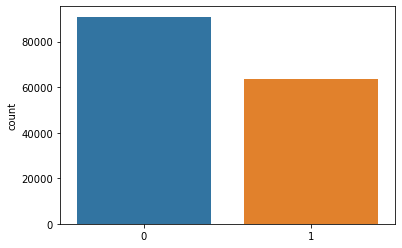

In [29]:
sns.countplot(y_smote)

### SMOTE with Undersampling

In [30]:
from imblearn.pipeline import Pipeline
over = SMOTE(sampling_strategy=0.3)
under = RandomUnderSampler(sampling_strategy=0.6)
steps = [('o', over), ('u', under)]
pipeline = Pipeline(steps=steps)

Notice that we have a different pipeline in this case.

In [31]:
X_smote_rus, y_smote_rus = pipeline.fit_resample(X_train, y_train)

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

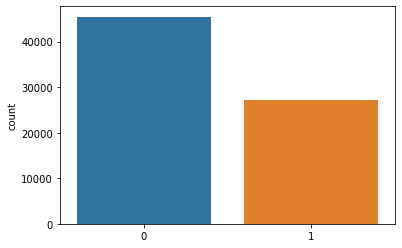

In [32]:
sns.countplot(y_smote_rus)

## Feature Selection

When we look at the dataframe it's obvious that we have lots of features. There's an important processing step that we didn't talk about before, it's feature selection. I will talk about feature selection more when we start learning Support Vector Machines, however, let's now use a function that simply selects important features for us. Here I will use an algorithm called Recursive Feature Elimination, RFE in short. For using this algorithm we will use `RFE()` function in sklearn, and pass the machine learning algorithm that we will use in addition to number of features that we want. You can find a detailed explanation for the function on MachineLearningMastery [link](https://machinelearningmastery.com/rfe-feature-selection-in-python/) also don't forget to check the [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.RFE.html)

Firstly, let's define RFE.

In [36]:
from sklearn.feature_selection import RFE
RFE_feaselector = RFE(estimator=LogisticRegression(C=1,fit_intercept=True, penalty="l2", warm_start=True,class_weight="balanced"),n_features_to_select= 40)


Now I will use `fit()` method on X_train and y_train

In [37]:
rfe = RFE_feaselector.fit(X_train,y_train)

After fitting, use `get_support()` method to get which columns to use.

In [38]:
selected_columns = rfe.get_support(1)
dataset_reduced = X_train[X_train.columns[selected_columns]] # reducing the size of datasets

In [39]:
def feature_selector(x,y):
    rfe = selector.fit(x,y)
    selected_columns = rfe_model.get_support(1)
    dataset_reduced = X_train[X_train.columns[selected_columns]]

We are ready to train our models on the processed data.

## Training Logistic Regression

I will use `GridSearchCV()` on every resampled X_train and y_train. I will do that using a for loop and for every model I will save performance metrics and best parameters.

Let's firstly convert our training sets into a form that we can loop through.

In [40]:
datasets={1:[X_rusmajority,yrusmajority],
         2:[X_rusfloat, yrusfloat],
         3:[X_rosmajority,yrosmajority],
         4:[X_rosfloat, yrosfloat],
         5:[X_smote, y_smote],
         6:[X_smote_rus, y_smote_rus]}

In [41]:
logreg=LogisticRegression()

In [42]:
params = {
    'C':[100, 10, 1.0, 0.1, 0.01],
    'l1_ratio': [0.25,0.50, 0.75, 0.90],
    'penalty': ["l2","l1","elasticnet"],
    'fit_intercept':[True,False],
    'warm_start':[True,False],
    
}

In [43]:
from sklearn.model_selection import GridSearchCV
gscv=GridSearchCV(logreg, params, cv=10,verbose=2,scoring="f1")

Now let's fit our model for every dataset variants we have.

In [44]:
f1_scores=[]
accuracy_scores=[]
best_parameters=[]
for i in datasets:
    
    model=gscv.fit(datasets[i][0], datasets[i][1])
    f1_scores.append(f1_score(y_test, model.predict(X_test)))
    accuracy_scores.append(accuracy_score(y_test, model.predict(X_test)))
    best_parameters.append(model.best_params_)

Fitting 10 folds for each of 240 candidates, totalling 2400 fits
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=100, fit_intercept=True, l1_ratio

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100

[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1

[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time= 

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_rati

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.4s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   2.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C

[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, f

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.

[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_inte

[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasti

[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C

[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, f

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.8s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s


[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.4s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, 

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.4s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] E

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s


[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=ela

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s


[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV]

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_in

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; tot

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; to

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=0.01, fit

[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; t

[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=

[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C

[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, f

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5,

[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_in

[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total

[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_s

[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   1.5s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, f

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True,

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.5s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.6s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.7s
[CV] EN

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0,

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_int

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.4s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=  

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s


[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_s

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.7s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.9s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.5s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] E

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.7s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.9s
[CV] END 

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[C

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_interce

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.8s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   1.9s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; 

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.6s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.2s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   7.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.2s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   7.2s
[CV] END C=1

[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time= 

[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.9s
[CV] END C=100, fit_intercept=False, l1_rati

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.4s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[C

[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_s

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   8.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   9.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   7.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercep

[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, pen

[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.9s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.3s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.9s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.3s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.4s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.4s
[CV] END C

[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_

[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.1s
[CV] END C=10, fit_intercept=False,

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.2s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   9.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.2s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.7s
[CV] EN

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.1s
[CV] END C=1.0,

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=T

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   8.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   9.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.3s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.4s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.8s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   9.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=  10.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   9.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.4s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.2s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.7s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.2s
[

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.7s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=  

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasti

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.5s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_s

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   9.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   9.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=  12.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_rati

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.7s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   8.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   9.8s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   8.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   8.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   9.8s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.1s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total tim

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total ti

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_interce

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.9s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   8.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   7.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total tim

[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END 

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=

[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.9s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.3s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.0s
[CV] END C=100, fi

[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=Fa

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.2s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.3s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.2s
[CV] 

[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5

[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   7.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   6.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   8.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   6.5s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   7.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   6.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   8.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   7.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   9.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   8.2s
[CV] END C=10, fit_i

[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True

[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.6s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   6.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   6.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   4.6s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_s

[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   5.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   5.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   7.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   6.8s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, f

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, 

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   6.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   4.9s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   6.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.5s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   5.2s
[C

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fi

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_inte

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.6s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.8s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   4.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.8s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.8s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.8s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[C

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.6s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s


[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   5.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.7s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   5.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   5.5s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasti

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   3.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   4.8s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_rati

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.5s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.8s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.6s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.7s


[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total t

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_inter

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   8.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.3s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   8.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.9s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   7.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.5s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.1s
[CV] END C=100, fi

[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] E

[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_r

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   6.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   7.2s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   9.2s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   7.2s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   9.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   7.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.1s
[CV

[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   5.8s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   4.6s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.5s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.7s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   4.9s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.5s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   4.8s
[CV] END C=10, fit_in

[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total ti

[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm

[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.9s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.7s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.4s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.6s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, 

[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, 

[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   7.4s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.7s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   6.5s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=  

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   5.2s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.1s
[CV] END C=1.0, fit_intercept=True, l

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.9s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.3s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.2s

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] E

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_inte

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.3s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   4.8s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   4.7s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.4s
[CV] 

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.5s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.5s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.9s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   7.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total tim

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=0.1, fit_intercept=False, l1

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   8.8s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.2s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   6.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time= 

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, w

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.7s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.1s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True;

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   4.8s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   5.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=True; total t

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=Fals

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.9s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   5.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.8s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.7s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   6.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=True; total tim

[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=False; total time=   3.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=True; total time=   0.0s
[CV] END 

[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=True, l1_rat

[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.3s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   2.8s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   4.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.6s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.7s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.1s
[CV] END C=100, fit_intercept=True, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.8s
[CV] END C=100,

[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; to

[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercept=False, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=100, fit_intercep

[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.5s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.7s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.9s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.1s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   3.6s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.8s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=100, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[

[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.25, penalty=elasticne

[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.5, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.0s
[CV]

[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.2s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.1s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=T

[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=Fals

[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=10, fit_intercept=False, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV]

[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=10, fit_intercept=False, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.5

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV]

[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=True, l1_ratio=0.9, penalty=el

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.25, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.1s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   4.4s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.3s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.7s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.5s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.6s


[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.

[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=1.0, fit_intercept=Fals

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   3.2s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=0.1, 

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[C

[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=True, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.7s
[CV] END C=0.1, fit_intercept=False, l1_rati

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.7s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.8s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.1s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.2s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.6s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[C

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.75, penalty=ela

[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.1, fit_intercept=False, l1_ratio=0.9, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   1.9s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.5s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.25, penalty=l2, warm_start=T

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.6s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.3s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l2, warm_start=False; total time=   2.4s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] EN

[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=True

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.3s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.2s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total time=   2.1s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.25, penalty=l2, warm_start=True; total tim

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.5, penalty=l1, warm_start=False; total time=   0.

[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=True; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.01, fit_intercept=False, l1_ratio=0.75, penalty=elasticnet, warm_start=False; total time=   0.0s
[CV] END C=0.

In [45]:
accuracy_scores

[0.7833424996562629,
 0.8129382648150695,
 0.7842362161418946,
 0.837206104771071,
 0.8159631513818232,
 0.8169943627113984]

In [46]:
f1_scores

[0.6098904499597697,
 0.6184265881363064,
 0.609372082892526,
 0.5993231810490692,
 0.6099941724941724,
 0.6045164165800029]

Looks like we improved the metrics slightly.

In [47]:
best_parameters

[{'C': 100,
  'fit_intercept': False,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True},
 {'C': 0.1,
  'fit_intercept': True,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True},
 {'C': 0.1,
  'fit_intercept': True,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True},
 {'C': 0.01,
  'fit_intercept': False,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True},
 {'C': 100,
  'fit_intercept': False,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True},
 {'C': 100,
  'fit_intercept': True,
  'l1_ratio': 0.25,
  'penalty': 'l2',
  'warm_start': True}]

We are done with Binary Classification but before getting on with Multiclass example I just want to share some important websites in which you can find more about resampling.

1. Github page of imblearn liberary: You can find names of other algorithms that you can use for resampling [link](https://github.com/scikit-learn-contrib/imbalanced-learn)
2. A very good article about how SMOTE works [link](https://towardsdatascience.com/introduction-to-synthetic-minority-over-sampling-technique-and-its-implementation-from-scratch-77593647c10d). Moreover, you can also directly read the paper on SMOTE. I don't generally prefer sharing research papers but this one is pretty easy I think, especially if you read the article on Medium you won't probably have much trouble reading this [paper](https://arxiv.org/pdf/1106.1813.pdf).
3. Also don't forget to check this article from MachineLearningMastery [link](https://machinelearningmastery.com/tactics-to-combat-imbalanced-classes-in-your-machine-learning-dataset/)

# Multiclass Classification

I was thinking of using a dataset in which we can practice preprocessing but I don't want to keep this notebook very long. Therefore, we will continue with a well-known toy dataset IRIS Flower.

In [49]:
from sklearn import datasets

Let's load the dataset and examine for class imbalance.

In [50]:
iris = datasets.load_iris()

In [51]:
predictors=pd.DataFrame(iris.data, columns=[iris.feature_names])
target=iris.target

C:\Users\gorke\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

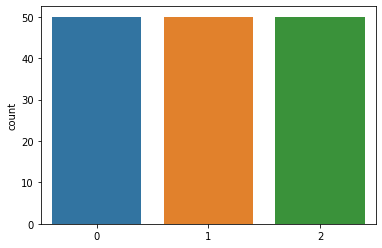

In [52]:
sns.countplot(target)

Looks like we have no problem with class imbalance. Before going on with constructing our LogisticRegression model, I will show two important cross validation functions: `RepeatedKFold()` and `LeaveOneOut()`.

## Cross Validation

Let's get started with `RepeatedKFold()`. The function involves a basic procedure, instead of using KFold cross validation for one time here we repeat the general KFold() cross validation procedure several times. Afterwards, the function generate overall prediction error by taking mean of the prediction error for every repeat. 


Another cross validation function that we will use is `LeaveOneOut()`. This algorithm trains repeatedly the model on all the instances except one and then use the omitted instance for prediction in test dataset. In other words, For n number of instances we train n number of models and each time leave out one instance for test set to predict. You can directly guess that using LeaveOneOut() strategy takes time because we train as much number of models as there are in our dataset.

I recommend reading MachineLearningMastery articles on both of these functions: [LeaveOneOut](https://machinelearningmastery.com/loocv-for-evaluating-machine-learning-algorithms/) and [RepeatedKFold](https://machinelearningmastery.com/repeated-k-fold-cross-validation-with-python/)

In [53]:
from sklearn.model_selection import RepeatedKFold
repeated_kfold = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)

The function above means that we will have 5 folds in each run and 15 in total. For every repeat, we shuffle the dataset and create 5 non-overlapping folds to use KFold cross validation.

In [54]:
from sklearn.model_selection import LeaveOneOut
loocv=LeaveOneOut()

In [55]:
logreg=LogisticRegression()

In [56]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(predictors, target, test_size = 0.2, random_state = 42)

Let's now define our GridSearchCV parameters. I will use almost the same parameters above for tuning except that I will also use **multi_class** parameter since we can use both one-vs-all and multinomial versions of Logistic Regression.

In [57]:
params = {
    'C':[100, 10, 1.0, 0.1, 0.01],
    'l1_ratio': [0.25,0.50, 0.75, 0.90],
    'penalty': ["l2","l1","elasticnet"],
    'multi_class':["ovr", "multinomial"],
    'fit_intercept':[True,False],
    'warm_start':[True,False],
    
}

Now I will create three models and use three different cross validation.

In [58]:
gscv=GridSearchCV(logreg, params, cv=5,verbose=10,scoring="accuracy")#StratifiedKFold

In [59]:
model1=gscv.fit(X_train,y_train)

Fitting 5 folds for each of 480 candidates, totalling 2400 fits
[CV 1/5; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/5; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 2/5; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/5; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/5; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/5; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 4/5; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 8/480] START C=100, fit_intercept=True, l1_r

[CV 1/5; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 4/5; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=Fa

[CV 5/5; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/5; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5

[CV 3/5; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 32/480] START C=100, fit_intercept=True

[CV 1/5; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 4/5; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=Fa

[CV 4/5; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 45/480] START C=100, fit_intercept=True, l1_ratio

[CV 2/5; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/5; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 4/5; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/5; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 5/5; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 57/480] START C=100, fit_in

[CV 5/5; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/5; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 4/5; 68/480] START C=100, fit_intercept=

[CV 2/5; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/5; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/5; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 4/5; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 80/480] START C=100, fit_intercept

[CV 3/5; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 4/5; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start

[CV 1/5; 93/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 93/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 93/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 93/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/5; 93/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 93/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 4/5; 93/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 93/480] START C=100, fit_intercept=False, l1_rati

[CV 3/5; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 1/5; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 104/480] START C=10, fit_intercept=True

[CV 2/5; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 4/5; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/5; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 1/5; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=Tr

[CV 5/5; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 1/5; 117/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 117/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 117/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 117/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 117/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/5; 117/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 117/480] START C=10, fit_intercept=True, l1_ratio=0.5

[CV 4/5; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 1/5; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 128/480] START C=10, fit_intercept=Tr

[CV 2/5; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 4/5; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/5; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 1/5; 135/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=Tr

[CV 3/5; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 4/5; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, wa

[CV 1/5; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 2/5; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/5; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/5; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/5; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 4/5; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=T

[CV 5/5; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 165/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 165/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 165/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 165/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 165/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/5; 165/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 165/480] START C=10, fit_intercept=False, l1_r

[CV 4/5; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 5/5; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 177/480] START C=10, fit_intercept=

[CV 4/5; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 188/480] START C=10, fit_intercept=Fa

[CV 5/5; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 195/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 195/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 195/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/5; 195/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 195/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/5; 195/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 195/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_star

[CV 3/5; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 4/5; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/5; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 207/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 207/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 207/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_star

[CV 2/5; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/5; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/5; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm

[CV 5/5; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 1/5; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/5; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/5; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 4/5; 224/480] START C=1.0, fit_in

[CV 5/5; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/5; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/5; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[

[CV 5/5; 239/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/5; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 1/5; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/5; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 2/5; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/5; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0

[CV 3/5; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 4/5; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/5; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/5; 248/480] START C=1.0, fit

[CV 1/5; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 2/5; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 4/5; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 5/5; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l

[CV 4/5; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 262/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/5; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 263/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 1/5; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 263/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 2/5; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 263/480

[CV 3/5; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 274/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/5; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 274/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/5; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 1/5; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 275/480] START

[CV 4/5; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 5/5; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/5; 285/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 285/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 285/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 285/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 285/480] START C=1.0, fit_intercept

[CV 4/5; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 296/480] START C=0.1, fit_inte

[CV 3/5; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 4/5; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 5/5; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/5; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 303/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_star

[CV 5/5; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.792 total time=   0.0s
[CV 2/5; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/5; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 4/5; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2

[CV 1/5; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 2/5; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/5; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/5; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/5; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 4/5; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/5; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=T

[CV 3/5; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 2/5; 332/480] START C=0.1, fit_intercept=Tru

[CV 2/5; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/5; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/5; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 4/5; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/5; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/5; 344/480] START C=0.1, fit_i

[CV 4/5; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 5/5; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.792 total time=   0.0s
[CV 2/5; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 3/5; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, 

[CV 1/5; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 2/5; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/5; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 4/5; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/5; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/5; 356/480] START C=0.1, fit_i

[CV 5/5; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/5; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/5; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, w

[CV 2/5; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 3/5; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/5; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 4/5; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 5/5; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm

[CV 1/5; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 2/5; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/5; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/5; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 4/5; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/5; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, mul

[CV 2/5; 388/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 388/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 3/5; 388/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 388/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 4/5; 388/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 388/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 5/5; 388/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 389/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=e

[CV 5/5; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 1/5; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.708 total time=   0.0s
[CV 2/5; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/5; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 3/5; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/5; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 4/5; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2

[CV 4/5; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 5/5; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 405/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 405/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 405/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/5; 405/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 405/480] START C=0.01, fit_intercep

[CV 3/5; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 4/5; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/5; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 1/5; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 2/5; 416/480] START C=0.01, fi

[CV 3/5; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 4/5; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/5; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 5/5; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/5; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 1/5; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/5; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.708 total time=   0.0s
[CV 2/5; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, wa

[CV 3/5; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 4/5; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/5; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 5/5; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/5; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 1/5; 429/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/5; 429/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 429/480] START C=0.01, fit_inte

[CV 5/5; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 1/5; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/5; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/5; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penal

[CV 4/5; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 442/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/5; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/5; 443/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 1/5; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 443/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 2/5; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[C

[CV 2/5; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/5; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/5; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/5; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 4/5; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 5/5; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 5/5; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan 

[CV 3/5; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 4/5; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/5; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 5/5; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/5; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.667 total time=   0.0s
[CV 1/5; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/5; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 2/5; 464/480] START C=0

[CV 3/5; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 4/5; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/5; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 5/5; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/5; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 1/5; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/5; 471/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/5; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penal

[CV 2/5; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/5; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 3/5; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/5; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 4/5; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/5; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 5/5; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

In [60]:
model1.best_params_

{'C': 100,
 'fit_intercept': False,
 'l1_ratio': 0.25,
 'multi_class': 'multinomial',
 'penalty': 'l2',
 'warm_start': True}

In [61]:
accuracy_score(gscv.predict(X_test),y_test)

0.9333333333333333

Now I will use a function to estimate elapsed time in GridSearchCV. I took this function from a stackoverflow discussion [link](https://datascience.stackexchange.com/questions/29495/how-to-estimate-gridsearchcv-computing-time)

In [62]:
def calculate_time(gscv):
    mean_fit_time= gscv.cv_results_['mean_fit_time']
    mean_score_time= gscv.cv_results_['mean_score_time']
    n_splits  = gscv.n_splits_ #number of splits of training data
    n_iter = pd.DataFrame(gscv.cv_results_).shape[0] #Iterations per split
    return print(np.mean(mean_fit_time + mean_score_time) * n_splits * n_iter)


In [63]:
calculate_time(gscv)

19.51252245903015


When we use StratifiedKFold with k=5, it more or less takes 18 seconds to complete the training. I tried to calculate the elapsed time by myself and it was around 20 seconds. I don't know actually why there is a difference but we can say that this calculate_time() function will show relatively the computing time difference between cross validation functions.

Let's go on with `RepeatedKFold()`.

In [64]:
gscv=GridSearchCV(logreg, params, cv=repeated_kfold,verbose=10,scoring="accuracy")

In [65]:
model2=gscv.fit(X_train,y_train)

Fitting 15 folds for each of 480 candidates, totalling 7200 fits
[CV 1/15; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/15; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 2/15; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 3/15; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 7/480] START C=100, fit_intercept=True, 

[CV 3/15; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/15; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=T

[CV 2/15; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 3/15; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 19/480] START C=100, fit_intercept=True,

[CV 4/15; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/15; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm

[CV 3/15; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 31/480] START C=100, fit_intercep

[CV 3/15; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/15; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0

[CV 15/15; 40/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 1/15; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/15; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 2/15; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 3/15; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9,

[CV 5/15; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 43/480] START C=100, fit_intercept=True,

[CV 5/15; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 6/15; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/15; 55/480] START C=100, fit_

[CV 2/15; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm

[CV 5/15; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 67/480] START C=100, fit_intercep

[CV 6/15; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/15; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 7/15; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/15; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 8/15; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/15; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 9/15; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   

[CV 9/15; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/15; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/15; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/15; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 12/15; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 13/15; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, p

[CV 4/15; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 79/480] START C=100, fit_i

[CV 2/15; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 3/15; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 4/15; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/15; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 5/15; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

[CV 6/15; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/15; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, war

[CV 5/15; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 6/15; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 6/15; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 7/15; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 8/15; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 8/15; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 9/15; 90/480] START C=100, fit_intercept

[CV 11/15; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 12/15; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 12/15; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 13/15; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 13/15; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 14/15; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 14/15; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 15/15; 92/480] START C=10

[CV 12/15; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/15; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 13/15; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 14/15; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 14/15; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 15/15; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 15/15; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 95/480] START C=100, fit_in

[CV 7/15; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 10/15; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 11/15; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_star

[CV 3/15; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 4/15; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/15; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 5/15; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 6/15; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 6/15; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/15; 101/480] START C=10, fit_intercept=True, 

[CV 8/15; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/15; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 10/15; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/15; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 11/15; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 12/15; 103/480] START C=10, fit_int

[CV 2/15; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/15; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/15; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/15; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 4/15; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 5/15; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 5/15; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total t

[CV 3/15; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/15; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/15; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 5/15; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 5/15; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 6/15; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 6/15; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 7/15; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_

[CV 3/15; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 115/480] START C=10, fit_intercept=True,

[CV 3/15; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 5/15; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm

[CV 2/15; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 127/480] START C=10, fit_intercep

[CV 14/15; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 15/15; 131/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 15/15; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/15; 132/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 1/15; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/15; 132/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 2/15; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total t

[CV 7/15; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 8/15; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 8/15; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 9/15; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/15; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 10/15; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 10/15; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 11/15; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, wa

[CV 2/15; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 6/15; 139/480] START C=10, fit_intercept=True,

[CV 1/15; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 2/15; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 11/15; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 12/15; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 12/15; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 13/15; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 13/15; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 14/15; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 14/15; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 15/15; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 3/15; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 151/480] START C=10, fit_i

[CV 3/15; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 4/15; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/15; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 5/15; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 6/15; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 6/15; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

[CV 4/15; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm

[CV 2/15; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.1s
[CV 6/15; 163/480] START C=10, fit_intercep

[CV 2/15; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 2/15; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 175/480] START C=10, fit_i

[CV 9/15; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 10/15; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 10/15; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 11/15; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 11/15; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 12/15; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 12/15; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 13/15; 177/480] START C=10, fit_in

[CV 4/15; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm

[CV 4/15; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 187/480] START C=10, fit_intercep

[CV 1/15; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 2/15; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 2/15; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 199/480] START C=1.0, fit_

[CV 8/15; 203/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/15; 203/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 9/15; 203/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 10/15; 203/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 10/15; 203/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 11/15; 203/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 11/15; 203/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan tot

[CV 10/15; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 11/15; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/15; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 12/15; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 13/15; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/15; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/15; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 3/15; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/15; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 211/480] START C=1.0, fit_interce

[CV 1/15; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/15; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 2/15; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 3/15; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 4/15; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   

[CV 8/15; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 10/15; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 11/15; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/15; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 12/15; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, pen

[CV 4/15; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 223/480] START C=1.0, fit_

[CV 15/15; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/15; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 2/15; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr,

[CV 4/15; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 235/480] START C=1.0, fit_interce

[CV 2/15; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/15; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 6/15; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, 

[CV 14/15; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 15/15; 244/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 15/15; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 245/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 1/15; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/15; 245/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 2/15; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 245/480] START C=1.0, fit_intercept=False, l1

[CV 1/15; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 2/15; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 2/15; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 247/480] START C=1.

[CV 8/15; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 9/15; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 9/15; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 10/15; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 10/15; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 11/15; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 11/15; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 12/15; 249/480] START C=1.0, 

[CV 7/15; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 10/15; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 11/15; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penal

[CV 1/15; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 2/15; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 2/15; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 3/15; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/15; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 259/480] START C=1.0, fit_

[CV 5/15; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 6/15; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, 

[CV 6/15; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 9/15; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/15; 271/480] START C=1

[CV 7/15; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/15; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 8/15; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/15; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 9/15; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 10/15; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 10/15; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=na

[CV 11/15; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 12/15; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 13/15; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/15; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/15; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 14/15; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 15/15; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 4/15; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/15; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 6/15; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 7/15; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 283/480] START C=1.0, fit_

[CV 6/15; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 7/15; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 8/15; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 8/15; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 9/15; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 9/15; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan 

[CV 15/15; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 1/15; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/15; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/15; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/15; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/15; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/15; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, 

[CV 5/15; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 295/480] START C=0.1, fit_

[CV 5/15; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 6/15; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 8/15; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm

[CV 3/15; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 4/15; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 307/480] START C=0.1, fit_interce

[CV 1/15; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 2/15; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 3/15; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/15; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 4/15; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/15; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 4/15; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 5/15; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 319/480] START C=0.1, fit_

[CV 3/15; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/15; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/15; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/15; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/15; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/15; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 6/15; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 322/480] START C=0.1, fit_i

[CV 7/15; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 8/15; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 10/15; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 11/15; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, w

[CV 6/15; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/15; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 9/15; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 10/15; 331/480] START C=0.1, fit_interc

[CV 6/15; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 7/15; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 8/15; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 9/15; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 10/15; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr,

[CV 12/15; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 13/15; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 13/15; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 14/15; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 14/15; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 15/15; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 15/15; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 343/480] STAR

[CV 4/15; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/15; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/15; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/15; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 6/15; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 7/15; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/15; 346/480] START C=0.1

[CV 11/15; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 12/15; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.500 total time=   0.0s
[CV 13/15; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/15; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 14/15; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 14/15; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 15/15; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, 

[CV 3/15; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 4/15; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 5/15; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/15; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 355/480] START C=0.1, fit_

[CV 1/15; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/15; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 2/15; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/15; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/15; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/15; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 4/15; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan 

[CV 12/15; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.500 total time=   0.0s
[CV 13/15; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 13/15; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 14/15; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 14/15; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.833 total time=   0.0s
[CV 15/15; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 15/15; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.958 total time=   0.0s
[CV 1/15; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, mul

[CV 6/15; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 7/15; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.958 total time=   0.0s
[CV 8/15; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 10/15; 367/480] START C=0

[CV 5/15; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 6/15; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 7/15; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 8/15; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 9/15; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 5/15; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 6/15; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 6/15; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 7/15; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 8/15; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 8/15; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 9/15; 378/480] START C=0.1, fit_i

[CV 15/15; 381/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 1/15; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 1/15; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 2/15; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 2/15; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/15; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 3/15; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/15; 382/480] START C=0.1, fit_i

[CV 9/15; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 10/15; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 11/15; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/15; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.625 total time=   0.0s
[CV 12/15; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.500 total time=   0.0s
[CV 13/15; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_clas

[CV 13/15; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 14/15; 390/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 14/15; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 15/15; 390/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 15/15; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 1/15; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 2/15; 391/480] START 

[CV 5/15; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/15; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/15; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 6/15; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/15; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 7/15; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/15; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 8/15; 394/480] END C=0.01, fit_intercept=True, l1_ratio

[CV 9/15; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 10/15; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 11/15; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/15; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.625 total time=   0.0s
[CV 12/15; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/15; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.500 total time=   0.0s
[CV 13/15; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 14/15; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 15/15; 401/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 15/15; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/15; 402/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 1/15; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/15; 402/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 2/15; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/15; 402/480] START C=0.01, fit_

[CV 14/15; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 15/15; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 15/15; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 1/15; 405/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/15; 405/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/15; 405/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/15; 405/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/15; 405/480] START C=0.01, f

[CV 7/15; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 8/15; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 9/15; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 10/15; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/15; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 11/15; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ov

[CV 11/15; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/15; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 12/15; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/15; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 13/15; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 14/15; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 14/15; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 15/15; 413/480] START C=0.

[CV 14/15; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 15/15; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 15/15; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 1/15; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/15; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.875 total time=   0.0s
[CV 2/15; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/15; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.917 total time=   0.0s
[CV 3/15; 416/480] STA

[CV 6/15; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 7/15; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 8/15; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/15; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 9/15; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/15; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.833 total time=   0.0s
[CV 10/15; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty

[CV 6/15; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.875 total time=   0.0s
[CV 7/15; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/15; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.792 total time=   0.0s
[CV 8/15; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/15; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 9/15; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/15; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.917 total time=   0.0s
[CV 10/15; 427/480] START C=0.01, fi

[CV 11/15; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/15; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 12/15; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/15; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 13/15; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 14/15; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 14/15; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 15/15; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.625 total time=   0.0s
[CV 1/15; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/15; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 2/15; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/15; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 3/15; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/15; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 4/15; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, mu

[CV 1/15; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.792 total time=   0.0s
[CV 2/15; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/15; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 3/15; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/15; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 4/15; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/15; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.708 total time=   0.0s
[CV 5/15; 440/4

[CV 1/15; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/15; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 2/15; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/15; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/15; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/15; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 4/15; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 1/15; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 2/15; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/15; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 3/15; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/15; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 4/15; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/15; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 5/15; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 2/15; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 3/15; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/15; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 4/15; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/15; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.708 total time=   0.0s
[CV 5/15; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/15; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.667 total time=   0.0s
[CV 6/15; 452/480] STA

[CV 14/15; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 15/15; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 15/15; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/15; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/15; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 2/15; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/15; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.667 total time=   0.0s
[CV 3/15; 457/480] START C=0.01

[CV 5/15; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 6/15; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 6/15; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/15; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 7/15; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/15; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 8/15; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/15; 461/480] START C=0.0

[CV 6/15; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.750 total time=   0.0s
[CV 7/15; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 7/15; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 8/15; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/15; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.708 total time=   0.0s
[CV 9/15; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 9/15; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.625 total time=   0.0s
[CV 10/15; 464/

[CV 4/15; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.667 total time=   0.0s
[CV 5/15; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/15; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.667 total time=   0.0s
[CV 6/15; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/15; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 7/15; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/15; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.625 total time=   0.0s
[CV 8/15; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 3/15; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.625 total time=   0.0s
[CV 4/15; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/15; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.708 total time=   0.0s
[CV 5/15; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/15; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.667 total time=   0.0s
[CV 6/15; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/15; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.750 total time=   0.0s
[CV 7/15; 475/480] START C=0.

In [66]:
model2.best_params_

{'C': 10,
 'fit_intercept': True,
 'l1_ratio': 0.25,
 'multi_class': 'multinomial',
 'penalty': 'l2',
 'warm_start': True}

In [67]:
accuracy_score(gscv.predict(X_test),y_test)

1.0

In [68]:
calculate_time(gscv)

57.550904989242554


Let's use Leave-One-Out strategy.

In [69]:
gscv=GridSearchCV(logreg, params, cv=loocv,verbose=10,scoring="accuracy")

In [70]:
model3=gscv.fit(X_train,y_train)

Fitting 120 folds for each of 480 candidates, totalling 57600 fits
[CV 1/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25,

[CV 33/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 34/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 35/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 36/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 69/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 70/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 70/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 71/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 72/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 105/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 105/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 106/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 107/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 1/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 108/120; 1/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, sco

[CV 19/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 20/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 21/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 22/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 22/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 54/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 55/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 56/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 57/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 94/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 95/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 96/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 97/120; 2/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 2/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 4/120; 4/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 4/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 5/120; 4/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 4/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 6/120; 4/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 4/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 7/120; 4/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 4/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_

[CV 6/120; 5/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/120; 5/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 7/120; 5/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/120; 5/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 8/120; 5/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/120; 5/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 9/120; 5/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 10/120; 5/480] START C=100, fit_intercept=True,

[CV 18/120; 6/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 6/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 19/120; 6/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 6/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 20/120; 6/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 6/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 21/120; 6/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 6/480] START C=100, fit_i

[CV 3/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 7/480] START C=100, fit_intercep

[CV 37/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 38/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 7/480] START C=100, fit_

[CV 72/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 74/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 75/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 7/480] START C=100, fit_

[CV 104/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 105/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 7/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 107/120; 7/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 7/480] START C=1

[CV 17/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 8/480] START C=10

[CV 51/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 8/480] START C=10

[CV 85/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 86/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 87/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 8/480] START C=10

[CV 115/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 116/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 117/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 8/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 8/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 8/480] ST

[CV 102/120; 9/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 9/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 103/120; 9/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 9/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 104/120; 9/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 9/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 105/120; 9/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 9/480] START C=100, fit_

[CV 41/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 41/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 42/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 43/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 44/120; 10/480] END C=100, fit_intercept=True, l1_ratio

[CV 94/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 95/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 95/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 96/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 10/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 97/120; 10/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 98/120; 10/480] START C=10

[CV 29/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 30/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 31/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 32/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 72/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 73/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 73/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 74/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 74/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 11/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 75/120; 11/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 48/120; 12/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 49/120; 12/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 49/120; 12/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 50/120; 12/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 50/120; 12/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 51/120; 12/480] START C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 51/120; 12/480] END C=100, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 5/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm

[CV 42/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 77/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 117/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 13/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 120/120; 13/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, pe

[CV 29/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 30/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 31/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 32/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 62/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 63/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 64/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 65/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 95/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 96/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 97/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 98/120; 14/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 14/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 20/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 21/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 22/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 23/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 23/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 24/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm

[CV 116/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 117/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 118/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 119/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 119/120; 15/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 15/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 11/120; 17/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 11/120; 17/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/120; 17/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 12/120; 17/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/120; 17/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 13/120; 17/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 14/120; 17/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 14/120; 17/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_cl

[CV 7/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 8/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 9/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 10/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 18/480] START C=100, fit_inter

[CV 108/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 109/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 109/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 110/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 110/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 111/120; 18/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 111/120; 18/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 112/120; 18/480] START C=1

[CV 23/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 24/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 24/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 25/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 25/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 26/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 26/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 27/120; 19/480] START C=100, fit

[CV 54/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 55/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 55/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 56/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 56/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 57/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 57/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 58/120; 19/480] START C=100, fit

[CV 87/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 88/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 19/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 19/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 19/480] START C=100, fit

[CV 4/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 6/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 7/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 20/480] START C=100, fit_

[CV 41/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 42/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 42/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 43/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 43/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 44/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 44/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 20/480] START C=1

[CV 74/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 75/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 76/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 77/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 20/480] START C=1

[CV 110/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 111/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 112/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 112/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/120; 20/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 113/120; 20/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 20/480] S

[CV 82/120; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 83/120; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 83/120; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 84/120; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 21/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 85/120; 21/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 21/480] START C=100, fit_interce

[CV 95/120; 22/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 22/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 96/120; 22/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 22/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 97/120; 22/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 98/120; 22/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 98/120; 22/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 99/120; 22/480] START C=100, fit_

[CV 101/120; 23/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 23/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 102/120; 23/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 23/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 103/120; 23/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 23/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 104/120; 23/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 111/120; 24/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 112/120; 24/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 112/120; 24/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 113/120; 24/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 113/120; 24/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 24/480] START C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 114/120; 24/480] END C=100, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 26/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 27/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 27/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 28/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 28/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 29/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 29/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 30/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 60/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 61/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 61/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 62/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 62/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 63/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 64/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 95/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 96/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 97/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 97/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 98/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 98/120; 25/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 99/120; 25/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 7/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 8/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 10/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr

[CV 42/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 43/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 43/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 44/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 44/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 45/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 46/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 77/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 78/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 79/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 80/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 81/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 110/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 111/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 112/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 112/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 113/120; 26/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 26/480] START C=100, fit_intercept=True, l1_ratio=0.75, mu

[CV 81/120; 27/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 82/120; 27/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 82/120; 27/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 83/120; 27/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 83/120; 27/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 27/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 84/120; 27/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 27/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 33/120; 28/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 28/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 34/120; 28/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 28/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 35/120; 28/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 28/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 36/120; 28/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 28/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, p

[CV 120/120; 28/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 1/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 2/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 3/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 29/480] START C=100, fit_intercept=Tru

[CV 71/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 72/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 72/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 73/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 73/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 74/120; 29/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 74/120; 29/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 29/480] START C=100, fit_

[CV 32/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 33/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 33/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 34/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 30/480] START C=10

[CV 92/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 93/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 93/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 94/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 94/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 95/120; 30/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 95/120; 30/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 30/480] START C=10

[CV 5/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 31/480] START C=100, fit_

[CV 38/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 31/480] START C=1

[CV 70/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 31/480] START C=1

[CV 107/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 109/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 31/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 110/120; 31/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 31/480] S

[CV 17/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 32/480] ST

[CV 50/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 32/480] ST

[CV 86/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 87/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 32/480] ST

[CV 116/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 117/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 32/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 119/120; 32/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 32

[CV 41/120; 33/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 42/120; 33/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 42/120; 33/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 43/120; 33/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 43/120; 33/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 44/120; 33/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 44/120; 33/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 45/120; 33/480] START C=100, fit_

[CV 52/120; 34/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 53/120; 34/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 53/120; 34/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 54/120; 34/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 54/120; 34/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 55/120; 34/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 55/120; 34/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 34/480] START C=10

[CV 64/120; 35/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 65/120; 35/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 65/120; 35/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 66/120; 35/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 66/120; 35/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 35/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 67/120; 35/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 79/120; 36/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 80/120; 36/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 80/120; 36/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 81/120; 36/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 81/120; 36/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 82/120; 36/480] START C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 82/120; 36/480] END C=100, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 7/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, w

[CV 40/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000

[CV 79/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 81/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 114/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 115/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 37/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 37/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 32/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 33/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 71/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 72/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 72/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 73/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 73/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 74/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 75/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 106/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 107/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 107/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 108/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 109/120; 38/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 38/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 20/120; 40/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 40/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 21/120; 40/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 40/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 22/120; 40/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 40/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 23/120; 40/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 40/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l

[CV 11/120; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/120; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 12/120; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/120; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 13/120; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 14/120; 41/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 14/120; 41/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 15/120; 41/480] START C=100, fit_interce

[CV 1/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 2/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 3/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 4/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 42/480] START C=100, fit_intercep

[CV 117/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 118/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 119/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 119/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 120/120; 42/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 120/120; 42/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 43/480] START C=100

[CV 31/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 32/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 32/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 33/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 34/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 43/480] START C=100, fit

[CV 64/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 65/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 65/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 66/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 66/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 67/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 67/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 68/120; 43/480] START C=100, fit

[CV 101/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 102/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 102/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 103/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 103/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 43/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 43/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 43/480] START C=

[CV 15/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 16/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 17/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 17/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 44/480] START C=1

[CV 48/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.1s
[CV 49/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 50/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 44/480] START C=1

[CV 80/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 81/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 81/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.1s
[CV 82/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 82/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 83/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 83/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/120; 44/480] START C=1

[CV 110/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 111/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.2s
[CV 112/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 112/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/120; 44/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 113/120; 44/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 44/480] S

[CV 57/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 58/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 59/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 60/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 61/120; 45/480] START C=100, fit_interce

[CV 92/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 93/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 93/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 94/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 94/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 95/120; 45/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 95/120; 45/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 96/120; 45/480] START C=100, fit_interce

[CV 4/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 6/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 7/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_cla

[CV 55/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 56/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 57/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 57/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 46/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 58/120; 46/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 46/480] START C=100, fit_

[CV 51/120; 47/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 52/120; 47/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 52/120; 47/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 53/120; 47/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 53/120; 47/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 54/120; 47/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 54/120; 47/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

[CV 22/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 23/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 24/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 25/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 25/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan 

[CV 60/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 60/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 61/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 62/120; 48/480] END C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 63/120; 48/480] START C=100, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 63/120

[CV 2/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, 

[CV 39/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 76/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 115/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 49/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 49/480] START C=100, fit_intercept=False, l1_ratio=0.25, m

[CV 31/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 32/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 33/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, mu

[CV 73/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 74/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 75/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 76/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, mu

[CV 110/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 111/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 112/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 112/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/120; 50/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 113/120; 50/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 50/480] START C=100, fit_intercept=False, l1_ratio=

[CV 36/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 37/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 38/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 39/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 39/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 40/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, 

[CV 105/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 105/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 106/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 107/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 51/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 108/120; 51/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=

[CV 112/120; 52/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 113/120; 52/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 113/120; 52/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 52/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 114/120; 52/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 52/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 115/120; 52/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 52/480] START C=100, fit_intercept=False, l1_ratio=0.25, mu

[CV 69/120; 53/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 70/120; 53/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 70/120; 53/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 71/120; 53/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 71/120; 53/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 72/120; 53/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 72/120; 53/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 73/120; 53/480] START C=10

[CV 55/120; 54/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 54/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 56/120; 54/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 57/120; 54/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 57/120; 54/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 54/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 58/120; 54/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 54/480] STA

[CV 3/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 55/480] START C=10

[CV 33/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 34/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 35/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 36/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 55/480] ST

[CV 72/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 74/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 75/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 55/480] ST

[CV 109/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 110/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 111/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 55/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 112/120; 55/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 55

[CV 22/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 23/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 24/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 56/

[CV 60/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 61/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 62/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 63/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 56/

[CV 97/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 98/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 99/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 56/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 100/120; 56/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 

[CV 29/120; 57/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 57/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 30/120; 57/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 57/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 31/120; 57/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 57/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 32/120; 57/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 33/120; 57/480] START C=10

[CV 7/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 8/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 9/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 58/480] START C=

[CV 87/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 88/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 88/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 89/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 89/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 90/120; 58/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 90/120; 58/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 91/120; 58/480] STA

[CV 10/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 11/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 11/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 12/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 13/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 83/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 84/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 85/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 59/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 86/120; 59/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 75/120; 60/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 76/120; 60/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 76/120; 60/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 77/120; 60/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 77/120; 60/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 78/120; 60/480] START C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 78/120; 60/480] END C=100, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 4/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 38/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, 

[CV 77/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, 

[CV 114/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 115/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 61/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 61/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 27/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 29/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 30/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=Fal

[CV 59/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 61/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.1s
[CV 62/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 62/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 92/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 93/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 94/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 62/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 95/120; 62/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=Fal

[CV 45/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 46/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 46/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 47/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 47/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 48/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 48/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 49/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 94/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 94/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 95/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 95/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 96/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 96/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 97/120; 63/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 97/120; 63/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan

[CV 13/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 14/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 14/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 15/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 15/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 16/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, p

[CV 65/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 66/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 66/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 67/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 67/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 68/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 68/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 69/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, p

[CV 107/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 108/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 108/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 109/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 109/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 110/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 110/120; 64/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 111/120; 64/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 53/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 54/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 54/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 55/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 55/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 56/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 56/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 65/480] START C=100, fit_

[CV 100/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 101/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 101/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 102/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 65/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 103/120; 65/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 65/480] START C=1

[CV 57/120; 66/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 66/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 58/120; 66/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 66/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 59/120; 66/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 66/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 60/120; 66/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 66/480] START C=10

[CV 2/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 67/480] START C=100, fit_

[CV 35/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 36/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 37/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 38/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.1s
[CV 39/120; 67/480] START C=1

[CV 70/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 67/480] START C=1

[CV 107/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 109/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 67/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 110/120; 67/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 67/480] S

[CV 18/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 21/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 22/120; 68/480] ST

[CV 50/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 68/480] ST

[CV 83/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 84/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 85/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 86/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 68/480] ST

[CV 113/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 114/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 115/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 115/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 68/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 116/120; 68/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 68

[CV 113/120; 69/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 69/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 114/120; 69/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 69/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 115/120; 69/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 69/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 116/120; 69/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 69/480] START C=1

[CV 4/120; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/120; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 5/120; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 6/120; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 6/120; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/120; 71/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 7/120; 71/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

[CV 15/120; 72/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 72/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 16/120; 72/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 72/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 17/120; 72/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 72/480] START C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 18/120; 72/480] END C=100, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 2/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, 

[CV 37/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 72/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 73/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 104/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 104/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 105/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 106/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 73/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 107/120; 73/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_

[CV 23/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 24/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, mu

[CV 57/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 58/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, mu

[CV 89/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 90/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 91/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 74/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 74/480] START C=100, fit_intercept=False, l1_ratio=0.75, mu

[CV 34/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 35/120; 75/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 35/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 75/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 36/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 75/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 37/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 75/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, 

[CV 119/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 75/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 120/120; 75/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 1/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 1/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 2/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr

[CV 114/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 115/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 116/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 117/120; 76/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 76/480] START C=100, fit_intercept=False, l1_ratio=0.75, mu

[CV 73/120; 77/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 74/120; 77/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 74/120; 77/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 77/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 75/120; 77/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 76/120; 77/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 76/120; 77/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 77/120; 77/480] START C=10

[CV 33/120; 78/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 78/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 34/120; 78/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 78/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 78/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 78/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 36/120; 78/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 78/480] STA

[CV 1/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 1/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 2/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 79/480] END C=100, fit_intercept=False, l1_ratio=

[CV 31/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 32/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 32/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 33/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 34/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 79/480] ST

[CV 65/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 66/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 66/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 67/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 67/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 68/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 68/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 69/120; 79/480] ST

[CV 99/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 100/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 100/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 101/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 101/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 102/120; 79/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 102/120; 79/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 103/120; 79/

[CV 12/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 13/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 13/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 14/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 14/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 15/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 15/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 80/

[CV 50/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 80/

[CV 85/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 86/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 87/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 80/

[CV 118/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 119/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 80/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 120/120; 80/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 81/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 81/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 81/48

[CV 111/120; 81/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 112/120; 81/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 112/120; 81/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 113/120; 81/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 113/120; 81/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 81/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 114/120; 81/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 81/480] ST

[CV 114/120; 82/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 82/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 115/120; 82/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 82/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 116/120; 82/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 82/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 117/120; 82/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 82/

[CV 107/120; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 108/120; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 109/120; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 110/120; 83/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 110/120; 83/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 73/120; 84/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 74/120; 84/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 74/120; 84/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 75/120; 84/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 75/120; 84/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 76/120; 84/480] START C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 76/120; 84/480] END C=100, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 5/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 44/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 47/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 81/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 84/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 118/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 85/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 120/120; 85/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=o

[CV 34/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 37/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 66/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 67/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 68/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 69/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 70/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 106/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 107/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 107/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 108/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 109/120; 86/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 86/480] START C=100, fit_intercept=False, l1_ratio=0.9, mu

[CV 66/120; 87/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 87/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 67/120; 87/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 68/120; 87/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 68/120; 87/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 69/120; 87/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 69/120; 87/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 70/120; 87/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 60/120; 88/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 88/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 61/120; 88/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 88/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 62/120; 88/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 63/120; 88/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 63/120; 88/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 64/120; 88/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, p

[CV 32/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 33/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 33/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 34/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 34/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 35/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 35/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 89/480] START C=100, fit_

[CV 103/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 103/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 104/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 105/120; 89/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 89/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 106/120; 89/480] END C=100, fit_intercept=False, l1_rat

[CV 101/120; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 102/120; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 102/120; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 103/120; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 103/120; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 104/120; 90/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 104/120; 90/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 105/120; 90/480] ST

[CV 14/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 15/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 15/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 16/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 16/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 17/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 17/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 18/120; 91/480] START C=1

[CV 49/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 50/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 51/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 52/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 53/120; 91/480] START C=1

[CV 86/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 87/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 88/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 91/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 91/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 91/480] START C=1

[CV 5/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 6/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 7/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 92/480] START C=10

[CV 36/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 37/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 38/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 39/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 39/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 40/120; 92/480] ST

[CV 71/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 72/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 72/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 73/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 73/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 74/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 92/480] ST

[CV 103/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 103/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 104/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 105/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 105/120; 92/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 106/120; 92/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 106/120; 92/480] END C=100, fit_intercept=

[CV 10/120; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 11/120; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 12/120; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 94/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 13/120; 94/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 14/120; 94/480] START C=10

[CV 23/120; 95/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 24/120; 95/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 24/120; 95/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 95/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 25/120; 95/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 95/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 26/120; 95/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 30/120; 96/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 31/120; 96/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 31/120; 96/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 32/120; 96/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 32/120; 96/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 33/120; 96/480] START C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 33/120; 96/480] END C=100, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 3/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm

[CV 37/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 71/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 72/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 73/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 108/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 109/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 97/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 97/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, 

[CV 25/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, sco

[CV 58/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 61/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 91/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 93/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 94/120; 98/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 98/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 24/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 25/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 26/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 27/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm

[CV 66/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 67/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 68/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 68/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 69/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 69/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 70/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm

[CV 111/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 112/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 112/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 113/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 113/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 114/120; 99/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 99/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=

[CV 52/120; 100/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 53/120; 100/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 53/120; 100/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 54/120; 100/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 54/120; 100/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 55/120; 100/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 55/120; 100/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 100/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, p

[CV 15/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 16/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 17/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 18/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 101/480] START C=10, fit_

[CV 101/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 102/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 103/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 101/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 104/120; 101/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 101/480] START C=

[CV 39/120; 102/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 102/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 40/120; 102/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 102/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 41/120; 102/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 102/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 42/120; 102/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 102/480] START C=1

[CV 1/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 2/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 103/480] START C=10, fit_

[CV 32/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 33/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 34/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 35/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 103/480] START C=

[CV 66/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 67/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 67/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 68/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 68/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 69/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 69/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 70/120; 103/480] START C=

[CV 103/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 105/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 103/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 103/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 103/480] 

[CV 17/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 104/480] S

[CV 51/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 104/480] S

[CV 85/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 86/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 87/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 104/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 104/480] S

[CV 120/120; 104/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 105/480] START C=10, fit_int

[CV 83/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 84/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 85/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 105/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 86/120; 105/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 87/120; 105/480] START C=10, fit_

[CV 61/120; 106/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 106/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 62/120; 106/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 63/120; 106/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 63/120; 106/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 64/120; 106/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 64/120; 106/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 65/120; 106/480] START C=1

[CV 51/120; 107/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 52/120; 107/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 52/120; 107/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 53/120; 107/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 53/120; 107/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 54/120; 107/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 54/120; 107/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 38/120; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 39/120; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 39/120; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 40/120; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 108/480] START C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 41/120; 108/480] END C=10, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 3/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm

[CV 39/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 72/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 73/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 108/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 109/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 109/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 109/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 25/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 63/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 64/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 65/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 66/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 99/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 100/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 101/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 102/120; 110/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 110/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class

[CV 13/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 14/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 14/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 15/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 15/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 16/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm

[CV 89/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 90/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 90/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 91/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 91/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 92/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 92/120; 111/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 93/120; 111/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm

[CV 80/120; 112/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 81/120; 112/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 81/120; 112/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 82/120; 112/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 82/120; 112/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 83/120; 112/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 83/120; 112/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 84/120; 112/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l

[CV 83/120; 113/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 113/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 84/120; 113/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 113/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 85/120; 113/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 113/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 86/120; 113/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 87/120; 113/480] START C=10, fit_interce

[CV 99/120; 114/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 100/120; 114/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 100/120; 114/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 101/120; 114/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 101/120; 114/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 102/120; 114/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 102/120; 114/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 103/120; 114/480] START C=1

[CV 12/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 13/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 13/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 14/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 15/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 15/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 16/120; 115/480] START C=10, fit

[CV 48/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 49/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 50/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 51/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 115/480] START C=10, fit

[CV 82/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 83/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 84/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 115/480] START C=10, fit

[CV 115/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 116/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 117/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 115/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 118/120; 115/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 115/480] START C

[CV 30/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 31/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 32/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 33/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 116/480] START C=

[CV 63/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 64/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 65/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 66/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 116/480] START C=

[CV 98/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 99/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 100/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 116/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 101/120; 116/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 116/480] STA

[CV 119/120; 117/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 117/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 120/120; 117/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 1/120; 118/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 1/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 118/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 2/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 118/480] START C=10, fit_inter

[CV 104/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 105/120; 118/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 105/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 106/120; 118/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 106/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 107/120; 118/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 107/120; 118/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 108/120; 118/480] START C=

[CV 93/120; 119/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 93/120; 119/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 94/120; 119/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 94/120; 119/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 95/120; 119/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 95/120; 119/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 96/120; 119/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 96/120; 119/4

[CV 74/120; 120/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 74/120; 120/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 75/120; 120/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 75/120; 120/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 76/120; 120/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 76/120; 120/480] END C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 77/120; 120/480] START C=10, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 77/120

[CV 5/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 38/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 77/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 111/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 112/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 113/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 114/120; 121/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 121/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 25/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 59/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 61/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 62/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 95/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 96/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 97/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 98/120; 122/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 122/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 32/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 33/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 33/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 34/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 34/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 35/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 35/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 102/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 103/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 104/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 105/120; 123/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 123/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 78/120; 124/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 78/120; 124/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 79/120; 124/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 79/120; 124/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 80/120; 124/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 80/120; 124/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 81/120; 124/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 81/120; 124/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, s

[CV 65/120; 125/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 66/120; 125/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 66/120; 125/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 125/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 67/120; 125/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 68/120; 125/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 68/120; 125/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 69/120; 125/480] START C=10, fit_

[CV 55/120; 126/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 126/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 56/120; 126/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 57/120; 126/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 57/120; 126/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 126/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 58/120; 126/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 126/480] START C=1

[CV 4/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 127/480] START C=10, fit_

[CV 42/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 127/480] START C=

[CV 78/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 79/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 80/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 81/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 127/480] START C=

[CV 115/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 116/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 117/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 118/120; 127/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 118/120; 127/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 127/480] 

[CV 28/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 29/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 30/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 31/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 128/480] S

[CV 64/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 65/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 66/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 67/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 128/480] S

[CV 100/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 101/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 102/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 128/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 103/120; 128/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 12

[CV 9/120; 130/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 130/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 130/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 130/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 11/120; 130/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 130/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 12/120; 130/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 130/480] START C=10

[CV 17/120; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 131/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 18/120; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 131/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 19/120; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 131/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 20/120; 131/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 18/120; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 132/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 19/120; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 132/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 20/120; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 132/480] START C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 21/120; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 120/120; 132/480] END C=10, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr

[CV 40/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 74/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 107/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 108/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 109/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 133/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 133/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 22/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 23/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 24/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 56/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 57/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 58/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 92/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 93/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 94/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 95/120; 134/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 134/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 56/120; 135/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 135/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 57/120; 135/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 135/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 58/120; 135/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 135/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 59/120; 135/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 135/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm

[CV 48/120; 136/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 49/120; 136/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 49/120; 136/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 50/120; 136/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 50/120; 136/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 51/120; 136/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 51/120; 136/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 52/120; 136/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l

[CV 45/120; 137/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 46/120; 137/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 46/120; 137/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 47/120; 137/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 47/120; 137/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 48/120; 137/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 48/120; 137/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 49/120; 137/480] START C=10, fit_interce

[CV 58/120; 138/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 138/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 59/120; 138/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 138/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 60/120; 138/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 138/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 61/120; 138/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 138/480] START C=10, fit_

[CV 3/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 139/480] START C=10, fit_interce

[CV 38/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 139/480] START C=10, fit

[CV 72/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 74/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 75/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 139/480] START C=10, fit

[CV 108/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 109/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 110/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 139/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 111/120; 139/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 139/480] START C

[CV 22/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 23/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 24/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 140/480] START C=

[CV 55/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 56/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 56/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 57/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 58/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 140/480] START C=

[CV 92/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 140/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 95/120; 140/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 140/480] START C=

[CV 13/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 14/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 14/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 15/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 15/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 16/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 141/480] START C=10, fit_interce

[CV 105/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 105/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 106/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 107/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 141/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 108/120; 141/480] END C=10, fit_intercept=True, l1_ratio=0.9, 

[CV 40/120; 142/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 142/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 41/120; 142/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 142/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 42/120; 142/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 142/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 43/120; 142/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 142/480] START C=10, fit_

[CV 23/120; 143/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 24/120; 143/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 24/120; 143/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 143/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 25/120; 143/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 143/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 26/120; 143/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total t

[CV 20/120; 144/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 144/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 21/120; 144/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 144/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 22/120; 144/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 144/480] START C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 23/120; 144/480] END C=10, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan 

[CV 3/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, 

[CV 37/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 79/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 81/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 145/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 145/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 1/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 4/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_clas

[CV 34/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 37/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, mu

[CV 75/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 76/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 77/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 78/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, mu

[CV 116/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 117/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 118/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 146/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 119/120; 146/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 146/480] START C=10, fit_intercept=False, l1_ratio=

[CV 84/120; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 85/120; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 86/120; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 87/120; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 87/120; 147/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 88/120; 147/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, 

[CV 101/120; 148/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 102/120; 148/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 102/120; 148/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 103/120; 148/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 103/120; 148/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 104/120; 148/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 104/120; 148/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 105/120; 148/480] START C=10, fit_intercept=False, l1_ratio=0.25, mu

[CV 120/120; 149/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/120; 150/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 1/120; 150/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 150/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 2/120; 150/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 150/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 3/120; 150/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 150/480] START C=1

[CV 2/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 151/480] START C=1

[CV 34/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 35/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 36/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 37/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 151/480] S

[CV 69/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 70/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 70/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 151/480] S

[CV 103/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 105/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 151/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 151/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 15

[CV 14/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 15/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 15/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 16/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 17/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 17/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 152

[CV 48/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 50/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 152

[CV 87/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 152/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 90/120; 152/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 152

[CV 22/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 23/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 23/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 24/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 24/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 25/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 153/480] START C=1

[CV 115/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 115/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 116/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 117/120; 153/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 153/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 118/120; 153/480] END C=10, fit_intercept=False,

[CV 85/120; 154/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 86/120; 154/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 86/120; 154/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 87/120; 154/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 87/120; 154/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 88/120; 154/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 88/120; 154/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 89/120; 154/480] ST

[CV 9/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 10/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 10/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 11/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 11/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 12/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, scor

[CV 41/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 41/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 42/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 42/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 43/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 43/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 44/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV

[CV 113/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 114/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 115/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 155/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 116/120; 155/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 57/120; 156/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 57/120; 156/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 156/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 58/120; 156/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 156/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 59/120; 156/480] END C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 156/480] START C=10, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Fa

[CV 4/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 40/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, sco

[CV 76/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, 

[CV 113/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 114/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 115/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 157/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 157/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 26/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 29/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 58/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 61/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 90/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 91/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 93/120; 158/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 158/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 14/120; 159/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 15/120; 159/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 15/120; 159/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 159/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 16/120; 159/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 159/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 17/120; 159/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 159/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 23/120; 160/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 160/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 24/120; 160/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 25/120; 160/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 25/120; 160/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 26/120; 160/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 26/120; 160/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 27/120; 160/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, p

[CV 31/120; 161/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 161/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 32/120; 161/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 33/120; 161/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 33/120; 161/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 34/120; 161/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 34/120; 161/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 35/120; 161/480] START C=10, fit_

[CV 47/120; 162/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 48/120; 162/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 48/120; 162/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 49/120; 162/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 49/120; 162/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 50/120; 162/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 50/120; 162/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 51/120; 162/480] START C=1

[CV 5/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 163/480] START C=10, fit_

[CV 38/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 163/480] START C=

[CV 70/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 163/480] START C=

[CV 107/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 109/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 163/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 110/120; 163/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 163/480] 

[CV 26/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 28/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 29/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 164/480] S

[CV 56/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 57/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 58/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 59/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 164/480] S

[CV 87/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 90/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 164/480] S

[CV 118/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 119/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 164/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 120/120; 164/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 165/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 165/480] END C=10, fit_intercept=False

[CV 6/120; 166/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 166/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 7/120; 166/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 166/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 8/120; 166/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 166/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 9/120; 166/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 166/480] START C=10, fit_

[CV 120/120; 166/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 1/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 2/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 3/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time= 

[CV 106/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 107/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 108/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 167/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 109/120; 167/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 116/120; 168/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 168/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 117/120; 168/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 168/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 118/120; 168/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 119/120; 168/480] START C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 119/120; 168/480] END C=10, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 28/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 29/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 29/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 30/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 30/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 31/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 31/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 32/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 60/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 61/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 61/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 62/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 62/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 63/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 64/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 94/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 95/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 95/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 96/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 97/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 97/120; 169/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 98/120; 169/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 7/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 8/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 10/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_c

[CV 46/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 47/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 47/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 48/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 49/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, mu

[CV 88/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 89/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 90/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 91/120; 170/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 170/480] START C=10, fit_intercept=False, l1_ratio=0.75, mu

[CV 1/120; 171/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 171/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/120; 171/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 171/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/120; 171/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 171/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 4/120; 171/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 5/120; 171/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=

[CV 9/120; 172/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 172/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 10/120; 172/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 172/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 11/120; 172/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 172/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 12/120; 172/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 172/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class

[CV 24/120; 173/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 173/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 25/120; 173/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 173/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 26/120; 173/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 173/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 27/120; 173/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 173/480] START C=1

[CV 38/120; 174/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 39/120; 174/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 39/120; 174/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 174/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 40/120; 174/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 174/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 41/120; 174/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 174/480] ST

[CV 4/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 175/480] START C=1

[CV 43/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 47/120; 175/480] S

[CV 78/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 79/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 80/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 81/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 175/480] S

[CV 112/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 113/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 114/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 175/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 115/120; 175/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 17

[CV 26/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 28/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 29/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 176

[CV 57/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 58/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 59/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 60/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 176

[CV 91/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 92/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 176/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 176/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 176

[CV 14/120; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 15/120; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 15/120; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 16/120; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 177/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 17/120; 177/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 177/480] START C=1

[CV 8/120; 178/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 178/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 9/120; 178/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 178/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 178/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 178/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 11/120; 178/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 178/480] START

[CV 19/120; 179/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 179/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 20/120; 179/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 179/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 21/120; 179/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 179/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 22/120; 179/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 21/120; 180/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 180/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 22/120; 180/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 180/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 23/120; 180/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 180/480] START C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 24/120; 180/480] END C=10, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 3/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 38/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 72/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 73/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 104/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 105/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 106/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 107/120; 181/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 181/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_cla

[CV 17/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 18/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 18/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 19/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 20/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 57/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 58/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 100/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 101/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 102/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 103/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 103/120; 182/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 182/480] START C=10, fit_intercept=False, l1_ratio=0.9, mu

[CV 7/120; 184/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 184/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 8/120; 184/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 184/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 9/120; 184/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 184/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 10/120; 184/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 184/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalt

[CV 28/120; 185/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 185/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 29/120; 185/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 185/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 30/120; 185/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 185/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 31/120; 185/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 185/480] START C=10, fit_

[CV 46/120; 186/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 47/120; 186/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 47/120; 186/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 48/120; 186/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 48/120; 186/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 49/120; 186/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 49/120; 186/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 50/120; 186/480] START C=1

[CV 6/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 187/480] START C=10, fit

[CV 38/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 187/480] START C=

[CV 70/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 187/480] START C=

[CV 105/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 107/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 187/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 187/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 187/480] 

[CV 23/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 24/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 26/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 188/480] S

[CV 62/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 63/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 64/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 65/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 188/480] S

[CV 93/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 95/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 188/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 96/120; 188/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 188/480] S

[CV 42/120; 189/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 43/120; 189/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 43/120; 189/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 44/120; 189/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 44/120; 189/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 45/120; 189/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 45/120; 189/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 46/120; 189/480] START C=10, fit_

[CV 42/120; 190/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 190/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 43/120; 190/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 190/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 44/120; 190/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 45/120; 190/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 45/120; 190/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 46/120; 190/480] START C=1

[CV 44/120; 191/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 45/120; 191/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 45/120; 191/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 46/120; 191/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 46/120; 191/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 47/120; 191/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 47/120; 191/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 53/120; 192/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 54/120; 192/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 54/120; 192/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 55/120; 192/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 55/120; 192/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 192/480] START C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 56/120; 192/480] END C=10, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 6/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr,

[CV 44/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 47/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 47/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 82/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 84/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 85/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 193/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 120/120; 193/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 39/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 39/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 40/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 40/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 41/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 41/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 42/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 42/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_s

[CV 76/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 77/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 78/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 79/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, mu

[CV 113/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 114/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 115/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 115/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 116/120; 194/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 194/480] START C=1.0, fit_intercept=True, l1_ratio=

[CV 38/120; 196/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 39/120; 196/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 39/120; 196/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 196/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 40/120; 196/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 196/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 41/120; 196/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 196/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_clas

[CV 61/120; 197/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 62/120; 197/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 62/120; 197/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 63/120; 197/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 63/120; 197/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 64/120; 197/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 64/120; 197/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 65/120; 197/480] START C=1

[CV 78/120; 198/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 79/120; 198/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 79/120; 198/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 80/120; 198/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 80/120; 198/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 81/120; 198/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 81/120; 198/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 82/120; 198/480] ST

[CV 5/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 199/480] START C=1

[CV 36/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 36/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 37/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 38/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 199/480] END C=1.0, fit_intercept=True, l

[CV 69/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 70/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 70/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 199/480] S

[CV 103/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 105/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 199/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 199/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 19

[CV 18/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 21/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 22/120; 200

[CV 48/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 50/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 200

[CV 79/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 80/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 81/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 81/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 82/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 82/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 83/120; 200

[CV 115/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 116/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 117/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 118/120; 200/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 200/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/

[CV 2/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 3/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 202/480] START C=1.

[CV 113/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 114/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 115/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 202/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 116/120; 202/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 202

[CV 6/120; 204/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 204/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 7/120; 204/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 204/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 8/120; 204/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 204/480] START C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 9/120; 204/480] END C=1.0, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 1/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=

[CV 36/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 37/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 73/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 108/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 109/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 205/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 205/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_cla

[CV 23/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 24/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 62/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 63/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 64/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 65/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 100/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 101/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 102/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 103/120; 206/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 206/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, mu

[CV 5/120; 208/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 208/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 6/120; 208/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 208/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 7/120; 208/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 208/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 8/120; 208/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 208/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l

[CV 15/120; 209/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 209/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 16/120; 209/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 209/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 17/120; 209/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 209/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 18/120; 209/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 209/480] START C=1.0, fit

[CV 19/120; 210/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 210/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 20/120; 210/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 210/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 21/120; 210/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 210/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 22/120; 210/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 210/480] START C=1

[CV 3/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 211/480] START C=1.0, fit

[CV 37/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 38/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 211/480] START C=

[CV 69/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 70/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 70/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 211/480] START C=

[CV 101/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 102/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 102/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 103/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 103/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 211/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 211/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 211/480] 

[CV 17/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 18/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 212/480] S

[CV 50/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 51/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 212/480] S

[CV 88/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 90/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 212/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 91/120; 212/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 212/480] S

[CV 1/120; 213/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 213/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/120; 213/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 213/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/120; 213/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 213/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 4/120; 213/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 5/120; 213/480] START C=1.0, fit_interce

[CV 9/120; 214/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 214/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 214/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 214/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 11/120; 214/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 214/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 12/120; 214/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 214/480] START C=1.

[CV 20/120; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 21/120; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 22/120; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 23/120; 215/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 23/120; 215/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 23/120; 216/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 216/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 24/120; 216/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 25/120; 216/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 25/120; 216/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 26/120; 216/480] START C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 26/120; 216/480] END C=1.0, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 4/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 40/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 77/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 116/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 217/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 217/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, m

[CV 33/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, mu

[CV 73/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 74/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 75/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 75/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 76/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, mu

[CV 113/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 114/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 115/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 115/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 116/120; 218/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 218/480] START C=1.0, fit_intercept=True, l1_ratio=

[CV 26/120; 219/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 219/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 27/120; 219/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 219/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 28/120; 219/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 219/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 29/120; 219/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 219/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 40/120; 220/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 220/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 41/120; 220/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 220/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 42/120; 220/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 220/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 43/120; 220/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 220/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 62/120; 221/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 63/120; 221/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 63/120; 221/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 64/120; 221/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 64/120; 221/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 65/120; 221/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 65/120; 221/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 66/120; 221/480] START C=1

[CV 80/120; 222/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 81/120; 222/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 81/120; 222/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 82/120; 222/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 82/120; 222/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 83/120; 222/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 83/120; 222/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 84/120; 222/480] ST

[CV 5/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 223/480] START C=1

[CV 38/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 223/480] S

[CV 70/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 71/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 72/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 73/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 223/480] S

[CV 105/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 107/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 223/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 223/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 22

[CV 22/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 23/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 24/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 224

[CV 53/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 55/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 56/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 224

[CV 87/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 224/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 90/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 224

[CV 120/120; 224/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 225/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 225/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 225/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/120; 225/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 225/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/120; 225/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 225/480] START C=1.0,

[CV 15/120; 226/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 226/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 16/120; 226/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 226/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 17/120; 226/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 226/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 18/120; 226/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 226/480] ST

[CV 15/120; 227/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 227/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 16/120; 227/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 227/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 17/120; 227/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 227/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 18/120; 227/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 2/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 228/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 228/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 4/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 228/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 5/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 119/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 120/120; 228/480] START C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 120/120; 228/480] END C=1.0, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 2/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 2/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 229/480] START C=1.0, fit

[CV 35/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 36/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 36/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 37/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 37/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 74/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 112/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 113/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 114/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 115/120; 229/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 229/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_cla

[CV 32/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 33/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 68/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 69/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 70/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 70/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 71/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 71/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 72/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 101/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 102/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 103/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 104/120; 230/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 105/120; 230/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, mu

[CV 77/120; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 78/120; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 78/120; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 79/120; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 79/120; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 80/120; 231/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 81/120; 231/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=

[CV 49/120; 232/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 50/120; 232/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 50/120; 232/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 51/120; 232/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 51/120; 232/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 52/120; 232/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 52/120; 232/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 53/120; 232/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, p

[CV 55/120; 233/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 56/120; 233/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 56/120; 233/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 233/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 57/120; 233/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 233/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 58/120; 233/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 233/480] START C=1.0, fit

[CV 62/120; 234/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 63/120; 234/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 63/120; 234/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 64/120; 234/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 64/120; 234/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 65/120; 234/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 65/120; 234/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 66/120; 234/480] START C=1

[CV 5/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 235/480] START C=1.0, fit

[CV 41/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 42/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 235/480] START C=

[CV 79/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 80/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 81/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 82/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 235/480] START C=

[CV 110/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 111/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 112/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 235/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 113/120; 235/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 235/480] 

[CV 22/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 23/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 24/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 24/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 236/480] S

[CV 52/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 55/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 236/480] S

[CV 83/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 84/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 85/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 86/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 236/480] S

[CV 115/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 116/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 117/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 118/120; 236/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 236/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 23

[CV 48/120; 237/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 49/120; 237/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 49/120; 237/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 50/120; 237/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 50/120; 237/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 51/120; 237/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 51/120; 237/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 52/120; 237/480] START C=1.0, fit

[CV 52/120; 238/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 53/120; 238/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 53/120; 238/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 54/120; 238/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 54/120; 238/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 55/120; 238/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 55/120; 238/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 238/480] START C=1

[CV 74/120; 239/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 239/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 75/120; 239/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 76/120; 239/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 76/120; 239/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 77/120; 239/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 77/120; 239/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 81/120; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 82/120; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 82/120; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 83/120; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 83/120; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 84/120; 240/480] START C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 84/120; 240/480] END C=1.0, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 7/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_

[CV 39/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, m

[CV 74/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, m

[CV 109/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 112/120; 241/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 241/480] START C=1.0, fit_intercept=False, l1_ratio

[CV 27/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 29/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 30/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=

[CV 65/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 66/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 67/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 68/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=

[CV 103/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 104/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 105/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 105/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 106/120; 242/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 106/120; 242/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 107/120; 242/480] START C=1.0, fit_intercept=False, l

[CV 77/120; 243/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 78/120; 243/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 78/120; 243/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 79/120; 243/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 79/120; 243/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 243/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 80/120; 243/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 81/120; 243/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 88/120; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 89/120; 244/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 89/120; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 90/120; 244/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 90/120; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 91/120; 244/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 91/120; 244/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 92/120; 244/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, mu

[CV 37/120; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 245/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 38/120; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 39/120; 245/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 39/120; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 40/120; 245/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 40/120; 245/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 41/120; 245/480] ST

[CV 32/120; 246/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 33/120; 246/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 33/120; 246/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 246/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 34/120; 246/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 246/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 246/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 246/

[CV 5/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 247/480] ST

[CV 44/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 47/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 247

[CV 82/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 83/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 84/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 247/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 247/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 247

[CV 2/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 248/

[CV 46/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 47/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 47/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 48/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/1

[CV 86/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 87/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 88/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 248/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 89/120; 248/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/1

[CV 79/120; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 80/120; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 81/120; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 81/120; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 82/120; 249/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 82/120; 249/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 83/120; 249/480] ST

[CV 92/120; 250/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 93/120; 250/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 93/120; 250/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 94/120; 250/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 94/120; 250/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 95/120; 250/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 95/120; 250/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 250/

[CV 102/120; 251/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 251/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 103/120; 251/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 251/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 104/120; 251/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 251/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 105/120; 251/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_st

[CV 118/120; 252/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 119/120; 252/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 119/120; 252/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 120/120; 252/480] START C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 120/120; 252/480] END C=1.0, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 1/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time

[CV 37/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 73/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 109/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 112/120; 253/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 253/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, m

[CV 23/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 24/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 24/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, mu

[CV 58/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 60/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 61/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, mu

[CV 94/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 95/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 96/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 97/120; 254/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 254/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, mu

[CV 8/120; 256/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 256/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 9/120; 256/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 256/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 10/120; 256/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 256/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 11/120; 256/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 256/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=o

[CV 17/120; 257/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 257/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 18/120; 257/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 257/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 19/120; 257/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 257/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 20/120; 257/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 257/480] START C=1

[CV 36/120; 258/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 258/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 37/120; 258/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 258/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 38/120; 258/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 39/120; 258/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 39/120; 258/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 258/480] ST

[CV 6/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 259/480] START C=

[CV 47/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 48/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 49/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 50/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 259/480] S

[CV 88/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 259/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 91/120; 259/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 92/120; 259/480] S

[CV 5/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 6/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 7/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 260/480] ST

[CV 37/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 38/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 39/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 39/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 40/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 40/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 41/120; 260

[CV 75/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 76/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 77/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 78/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 260

[CV 109/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 110/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 111/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 112/120; 260/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 112/120; 260/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/

[CV 25/120; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 26/120; 262/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 26/120; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 27/120; 262/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 27/120; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 28/120; 262/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 28/120; 262/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 262/480] ST

[CV 40/120; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 41/120; 263/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 41/120; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 42/120; 263/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 42/120; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 43/120; 263/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 43/120; 263/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 57/120; 264/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 264/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 58/120; 264/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 264/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 59/120; 264/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 264/480] START C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 60/120; 264/480] END C=1.0, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 7/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_

[CV 45/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 47/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 48/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, m

[CV 81/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 84/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, m

[CV 119/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 265/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 120/120; 265/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75,

[CV 33/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=

[CV 69/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 70/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 70/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 71/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 71/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 72/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 72/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 73/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=

[CV 107/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 108/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 109/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 266/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 110/120; 266/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 266/480] START C=1.0, fit_intercept=False, l

[CV 2/120; 268/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 268/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 3/120; 268/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 268/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 4/120; 268/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 268/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 5/120; 268/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 268/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_clas

[CV 15/120; 269/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 269/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 16/120; 269/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 269/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 17/120; 269/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 269/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 18/120; 269/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 269/480] ST

[CV 33/120; 270/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 270/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 34/120; 270/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 270/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 270/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 270/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 36/120; 270/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 270/

[CV 5/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 271/480] ST

[CV 42/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 271

[CV 83/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 84/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 271/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 86/120; 271/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 271

[CV 2/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 272/

[CV 42/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 43/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 43/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 44/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 44/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 45/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 46/1

[CV 80/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 81/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 81/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 82/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 82/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 83/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 83/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/1

[CV 119/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 119/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 272/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 120/120; 272/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 273/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 273/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 273/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/120; 273/480] END C=1.0, fit_intercep

[CV 56/120; 273/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 273/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 57/120; 273/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 273/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 58/120; 273/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 273/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 59/120; 273/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 273/480] ST

[CV 57/120; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 58/120; 274/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 58/120; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 274/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 59/120; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 274/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 60/120; 274/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 274/

[CV 56/120; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 57/120; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 58/120; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 275/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 59/120; 275/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 27/120; 276/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 28/120; 276/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 28/120; 276/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 276/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 29/120; 276/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 30/120; 276/480] START C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 30/120; 276/480] END C=1.0, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 4/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 38/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 41/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_cla

[CV 73/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 75/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_cla

[CV 105/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 106/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 107/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 107/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 108/120; 277/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 277/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, m

[CV 19/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 20/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 21/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 22/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 22/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, mu

[CV 52/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 53/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 54/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 55/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 56/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, mu

[CV 85/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 86/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 87/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 88/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, mu

[CV 118/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 118/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 119/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 278/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 120/120; 278/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 279/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/120; 279/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, war

[CV 65/120; 279/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 66/120; 279/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 66/120; 279/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 279/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 67/120; 279/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 68/120; 279/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 68/120; 279/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 69/120; 279/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 34/120; 280/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 280/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 35/120; 280/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 280/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 36/120; 280/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 280/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 37/120; 280/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 280/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 7/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 8/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 9/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 10/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 10/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 11/120; 281/480] START C=1.0, f

[CV 108/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 109/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 110/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 110/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 111/120; 281/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 111/120; 281/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 112/120; 281/480] S

[CV 41/120; 282/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 282/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 42/120; 282/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 282/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 43/120; 282/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 282/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 44/120; 282/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 45/120; 282/480] ST

[CV 4/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 283/480] START C=1

[CV 41/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 42/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 283/480] S

[CV 84/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 86/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 283/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 87/120; 283/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 283/480] S

[CV 7/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 9/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 10/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 284/480]

[CV 46/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 47/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 47/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 48/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 284

[CV 82/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 83/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 83/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 84/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 284/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 85/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 284

[CV 120/120; 284/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 285/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 1/120; 285/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 285/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 2/120; 285/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 285/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 3/120; 285/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 285/480] START C=1.0,

[CV 13/120; 286/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 14/120; 286/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 14/120; 286/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 15/120; 286/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 15/120; 286/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 286/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 16/120; 286/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 286/480] ST

[CV 10/120; 287/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 11/120; 287/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 11/120; 287/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 12/120; 287/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 12/120; 287/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 13/120; 287/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 13/120; 287/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 11/120; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 12/120; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 13/120; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 14/120; 288/480] START C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 14/120; 288/480] END C=1.0, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 2/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 4/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, 

[CV 43/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 47/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 75/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 117/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 289/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 120/120; 289/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, mul

[CV 38/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 39/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 39/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 40/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 40/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 41/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 41/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 42/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, mu

[CV 78/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 79/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 80/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 81/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 81/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 82/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, mu

[CV 119/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 120/120; 290/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 120/120; 290/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=

[CV 111/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 112/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 112/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 113/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 113/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 114/120; 291/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 291/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_cla

[CV 114/120; 292/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 292/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 115/120; 292/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 292/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 116/120; 292/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 292/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 117/120; 292/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 292/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, mu

[CV 113/120; 293/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 293/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 114/120; 293/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 293/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 115/120; 293/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 293/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 116/120; 293/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 293/480] S

[CV 114/120; 294/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 294/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 115/120; 294/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 294/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 116/120; 294/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 294/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 117/120; 294/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 294

[CV 27/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 28/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 28/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 29/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 29/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 30/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 30/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 31/120; 295/480] S

[CV 65/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 66/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 66/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 67/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 67/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 68/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 68/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 69/120; 295/480] S

[CV 95/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 96/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 97/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 97/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 98/120; 295/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 98/120; 295/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 99/120; 295/480] S

[CV 7/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 9/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 10/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 296/480]

[CV 37/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 38/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 39/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 39/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 40/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 40/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 41/120; 296

[CV 74/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 75/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 75/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 76/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 77/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 296

[CV 105/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 106/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 106/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 107/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 107/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 296/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 108/120; 296/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/

[CV 87/120; 297/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 88/120; 297/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 88/120; 297/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 89/120; 297/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 89/120; 297/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 90/120; 297/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 90/120; 297/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 91/120; 297/480] START C=0

[CV 82/120; 298/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 83/120; 298/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 83/120; 298/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 84/120; 298/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 84/120; 298/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 85/120; 298/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 85/120; 298/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 86/120; 298/480] ST

[CV 94/120; 299/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 95/120; 299/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 95/120; 299/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 96/120; 299/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 96/120; 299/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 97/120; 299/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 97/120; 299/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 109/120; 300/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 110/120; 300/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 110/120; 300/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 111/120; 300/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 111/120; 300/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 112/120; 300/480] START C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 112/120; 300/480] END C=0.1, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 21/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 22/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 22/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 23/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 23/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 24/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 24/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 25/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 62/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 63/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 64/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 64/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 65/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 65/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 66/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 102/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 103/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 103/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 104/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 105/120; 301/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 301/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_cla

[CV 14/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 15/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 15/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 16/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 17/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 17/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 18/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 46/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 47/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 47/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 48/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 49/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 87/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 88/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 88/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 89/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 90/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 90/120; 302/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 91/120; 302/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 107/120; 303/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 108/120; 303/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 109/120; 303/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 110/120; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 110/120; 303/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 111/120; 303/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 84/120; 304/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 85/120; 304/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 85/120; 304/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 86/120; 304/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 86/120; 304/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 87/120; 304/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 87/120; 304/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 88/120; 304/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, p

[CV 100/120; 305/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 101/120; 305/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 101/120; 305/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 305/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 102/120; 305/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 305/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 103/120; 305/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 104/120; 305/480] START C=

[CV 111/120; 306/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 112/120; 306/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 112/120; 306/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 113/120; 306/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 113/120; 306/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 306/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 114/120; 306/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 306/480] S

[CV 29/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 30/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 30/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 31/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 31/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 32/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 32/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 307/480] START C=

[CV 60/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 61/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 61/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 62/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 62/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 63/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 64/120; 307/480] START C=

[CV 101/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 102/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 102/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 103/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 103/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 104/120; 307/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 104/120; 307/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 105/120; 307/480] 

[CV 18/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 19/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 19/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 20/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 20/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 21/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 21/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 22/120; 308/480] S

[CV 54/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 55/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 56/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 57/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 308/480] S

[CV 92/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 308/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 95/120; 308/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 308/480] S

[CV 15/120; 309/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 16/120; 309/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 16/120; 309/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 309/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 17/120; 309/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 309/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 18/120; 309/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 309/480] START C=0.1, fit

[CV 16/120; 310/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 310/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 17/120; 310/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 310/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 18/120; 310/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 310/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 19/120; 310/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 310/480] START C=0

[CV 24/120; 311/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 25/120; 311/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 25/120; 311/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 26/120; 311/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 26/120; 311/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 311/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 27/120; 311/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 43/120; 312/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 312/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 44/120; 312/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 45/120; 312/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 45/120; 312/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 46/120; 312/480] START C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 46/120; 312/480] END C=0.1, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 5/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, 

[CV 47/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 48/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 49/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 50/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 88/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 89/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 90/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 91/120; 313/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 92/120; 313/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 6/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 7/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 8/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 8/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 44/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 45/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 46/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 46/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 47/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 47/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, mu

[CV 82/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 83/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 83/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 84/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 84/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 85/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 314/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, mu

[CV 120/120; 314/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 315/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 1/120; 315/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 315/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 2/120; 315/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 315/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 3/120; 315/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 315/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, pen

[CV 12/120; 316/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 316/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 13/120; 316/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 14/120; 316/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 14/120; 316/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 15/120; 316/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 15/120; 316/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 316/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_clas

[CV 26/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 27/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 28/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 29/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 317/480] START C=0

[CV 98/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 99/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 99/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 100/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 100/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 101/120; 317/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 101/120; 317/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 317/480] STAR

[CV 52/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 53/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 53/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 54/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 54/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 55/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 55/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 56/120; 318/480] ST

[CV 98/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 99/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 99/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 100/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 100/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 101/120; 318/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 101/120; 318/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 102/120; 318/48

[CV 17/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 18/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 18/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 19/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 19/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 20/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 20/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 21/120; 319/480] S

[CV 50/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 51/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 52/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 53/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 53/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 54/120; 319/480] S

[CV 87/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 88/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 319/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 319/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 319/480] S

[CV 7/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 8/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 9/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 10/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 320/480]

[CV 46/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 47/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 47/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 48/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 49/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 320

[CV 77/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 78/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 79/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 80/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 81/120; 320

[CV 107/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 108/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 109/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 320/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 110/120; 320/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/

[CV 89/120; 321/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 90/120; 321/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 90/120; 321/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 91/120; 321/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 91/120; 321/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 92/120; 321/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 92/120; 321/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 93/120; 321/480] START C=0

[CV 107/120; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 108/120; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 108/120; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 109/120; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 109/120; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 110/120; 322/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 110/120; 322/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 111/120; 322

[CV 120/120; 323/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 1/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 2/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 3/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sc

[CV 116/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 117/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 118/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 119/120; 324/480] START C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 119/120; 324/480] END C=0.1, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 30/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 31/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 31/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 32/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 32/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 33/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 70/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 71/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 71/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 72/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 72/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 73/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 73/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, 

[CV 108/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 108/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 109/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 325/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 325/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=Tr

[CV 27/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 29/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 30/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 68/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 69/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 70/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 70/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 71/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 71/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 72/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 110/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 111/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 112/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 112/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 113/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 113/120; 326/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 326/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, mu

[CV 7/120; 328/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 328/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 8/120; 328/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 328/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 9/120; 328/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 328/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 10/120; 328/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 328/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalt

[CV 28/120; 329/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 329/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 29/120; 329/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 329/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 30/120; 329/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 329/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 31/120; 329/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 329/480] START C=0.1, fit

[CV 34/120; 330/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 330/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 330/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 330/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 36/120; 330/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 330/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 37/120; 330/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 330/480] START C=0

[CV 4/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 331/480] START C=0.1, fit

[CV 40/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 42/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 331/480] START C=

[CV 75/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 76/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 77/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 78/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 331/480] START C=

[CV 105/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 107/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 107/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 331/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 331/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/120; 331/480] 

[CV 25/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 26/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 28/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 332/480] S

[CV 64/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 65/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 66/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 67/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 332/480] S

[CV 94/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 95/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 96/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 332/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 97/120; 332/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 332/480] S

[CV 51/120; 333/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 52/120; 333/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 52/120; 333/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 53/120; 333/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 53/120; 333/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 54/120; 333/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 54/120; 333/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 55/120; 333/480] START C=0.1, fit

[CV 62/120; 334/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 63/120; 334/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 63/120; 334/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 64/120; 334/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 64/120; 334/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 65/120; 334/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 65/120; 334/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 66/120; 334/480] START C=0

[CV 78/120; 335/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 79/120; 335/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 79/120; 335/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 335/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 80/120; 335/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 81/120; 335/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 81/120; 335/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 96/120; 336/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 336/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 97/120; 336/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 98/120; 336/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 98/120; 336/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 99/120; 336/480] START C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 99/120; 336/480] END C=0.1, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, sco

[CV 12/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 13/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 14/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 15/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 15/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 16/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, m

[CV 51/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 52/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 53/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 53/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 54/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 54/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 55/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, m

[CV 94/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 95/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 95/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 96/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 97/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 97/120; 337/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 98/120; 337/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, m

[CV 13/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 14/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 14/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 15/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 15/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 16/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 17/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=

[CV 55/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 56/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 57/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 58/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=

[CV 97/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 98/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 99/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 338/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 100/120; 338/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 338/480] START C=0.1, fit_intercept=False, l1_rat

[CV 34/120; 339/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 35/120; 339/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 35/120; 339/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 339/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 36/120; 339/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 339/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 37/120; 339/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 339/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_cla

[CV 36/120; 340/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 340/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 37/120; 340/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 340/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 38/120; 340/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 39/120; 340/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 39/120; 340/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 340/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, mu

[CV 46/120; 341/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 47/120; 341/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 47/120; 341/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 48/120; 341/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 48/120; 341/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 49/120; 341/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 49/120; 341/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 50/120; 341/480] ST

[CV 58/120; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 59/120; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 60/120; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 342/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 61/120; 342/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 342/

[CV 10/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 11/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 12/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 13/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 13/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/120; 343

[CV 43/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 343

[CV 77/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 78/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 79/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 80/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 81/120; 343

[CV 111/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 112/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 113/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 343/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 114/120; 343/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/

[CV 26/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 28/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 29/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/1

[CV 62/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 63/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 64/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 65/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/1

[CV 95/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 96/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 97/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 97/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 344/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 98/120; 344/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/1

[CV 72/120; 345/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 73/120; 345/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 73/120; 345/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 74/120; 345/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 74/120; 345/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 345/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 75/120; 345/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 76/120; 345/480] ST

[CV 65/120; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 66/120; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 66/120; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 67/120; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 67/120; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 68/120; 346/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 68/120; 346/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 69/120; 346/

[CV 64/120; 347/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 65/120; 347/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 65/120; 347/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 66/120; 347/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 66/120; 347/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 67/120; 347/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 67/120; 347/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 43/120; 348/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 44/120; 348/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 44/120; 348/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 45/120; 348/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 45/120; 348/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 46/120; 348/480] START C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 46/120; 348/480] END C=0.1, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 6/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr,

[CV 44/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 47/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 83/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 84/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 84/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 85/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 86/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_cla

[CV 118/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 349/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 120/120; 349/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi

[CV 35/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 36/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 37/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 38/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 38/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 39/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, mu

[CV 77/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 78/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 79/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 80/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 81/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, mu

[CV 114/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 115/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 115/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 116/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 117/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 117/120; 350/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 350/480] START C=0.1, fit_intercept=False, l1_ratio

[CV 58/120; 351/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 351/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 59/120; 351/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 351/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 60/120; 351/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 61/120; 351/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 61/120; 351/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 62/120; 351/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, 

[CV 70/120; 352/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 71/120; 352/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 71/120; 352/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 72/120; 352/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 72/120; 352/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 73/120; 352/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 73/120; 352/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 74/120; 352/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_clas

[CV 82/120; 353/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 83/120; 353/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 83/120; 353/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 84/120; 353/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 84/120; 353/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 85/120; 353/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 85/120; 353/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 86/120; 353/480] START C=0

[CV 95/120; 354/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 354/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 96/120; 354/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 354/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 97/120; 354/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 98/120; 354/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 98/120; 354/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 99/120; 354/480] ST

[CV 15/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 16/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 16/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 17/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 17/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 18/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 18/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 19/120; 355/480] S

[CV 49/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 50/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 51/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 52/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 53/120; 355/480] S

[CV 84/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 86/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 87/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 355/480] S

[CV 118/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 119/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 355/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 120/120; 355/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 356/48

[CV 32/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 33/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 34/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 35/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 356

[CV 65/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 66/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 67/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 68/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 356

[CV 100/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 101/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 101/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 102/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 102/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 356/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 103/120; 356/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/

[CV 116/120; 357/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 357/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 117/120; 357/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 357/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 118/120; 357/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 119/120; 357/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 119/120; 357/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 357/480] S

[CV 6/120; 359/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 7/120; 359/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 7/120; 359/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 8/120; 359/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 8/120; 359/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 9/120; 359/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 9/120; 359/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan 

[CV 23/120; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 24/120; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 25/120; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 25/120; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 26/120; 360/480] START C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 26/120; 360/480] END C=0.1, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 3/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 4/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 43/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, m

[CV 78/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 80/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 81/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 81/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 82/120; 361/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, m

[CV 120/120; 361/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 1/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 2/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 3/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 4/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, m

[CV 42/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 43/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 43/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 44/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 44/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 45/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 46/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=

[CV 83/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 84/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 84/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 85/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 86/120; 362/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 362/480] START C=0.1, fit_intercept=False, l1_ratio=

[CV 27/120; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 28/120; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 29/120; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 30/120; 363/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 363/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_cla

[CV 32/120; 364/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 33/120; 364/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 33/120; 364/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 34/120; 364/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 34/120; 364/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 364/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 35/120; 364/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 364/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, mu

[CV 44/120; 365/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 45/120; 365/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 45/120; 365/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 46/120; 365/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 46/120; 365/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 47/120; 365/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 47/120; 365/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 48/120; 365/480] ST

[CV 58/120; 366/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 59/120; 366/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 59/120; 366/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 60/120; 366/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 60/120; 366/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 61/120; 366/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 61/120; 366/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 62/120; 366/

[CV 9/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 10/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 11/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 12/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 13/120; 367/

[CV 41/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 42/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 367

[CV 75/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 76/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 77/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 78/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 367

[CV 110/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 111/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 112/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 367/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 113/120; 367/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/

[CV 24/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 26/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/1

[CV 57/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 58/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 59/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 60/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/1

[CV 91/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 92/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 92/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 368/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 368/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 95/1

[CV 36/120; 369/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 369/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 37/120; 369/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 369/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 38/120; 369/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 39/120; 369/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 39/120; 369/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 40/120; 369/480] ST

[CV 34/120; 370/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 370/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 35/120; 370/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 370/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 36/120; 370/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 370/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 37/120; 370/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 370/

[CV 35/120; 371/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 371/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 36/120; 371/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 371/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 37/120; 371/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 371/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 38/120; 371/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 34/120; 372/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 372/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 35/120; 372/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 372/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 36/120; 372/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 372/480] START C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 37/120; 372/480] END C=0.1, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 5/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 8/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 48/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 49/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 49/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 50/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 51/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 51/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_cla

[CV 89/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 90/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 91/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 91/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 92/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 92/120; 373/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 93/120; 373/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_cla

[CV 10/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 10/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 11/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 12/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 12/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 13/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 13/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_s

[CV 49/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 50/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 50/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 51/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 51/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 52/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, mu

[CV 84/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 85/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 85/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 86/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 87/120; 374/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 88/120; 374/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, mu

[CV 30/120; 375/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 375/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 31/120; 375/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 375/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 32/120; 375/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 33/120; 375/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 33/120; 375/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 34/120; 375/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, 

[CV 39/120; 376/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 40/120; 376/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 40/120; 376/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 41/120; 376/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 41/120; 376/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 42/120; 376/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 42/120; 376/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 43/120; 376/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_clas

[CV 55/120; 377/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 56/120; 377/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 56/120; 377/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 57/120; 377/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 57/120; 377/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 377/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 58/120; 377/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 377/480] START C=0

[CV 64/120; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 65/120; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 65/120; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 66/120; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 66/120; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 67/120; 378/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 67/120; 378/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 68/120; 378/480] ST

[CV 10/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 11/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 12/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 13/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 13/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 14/120; 379/480] S

[CV 43/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 44/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 45/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 379/480] S

[CV 76/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 77/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 78/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 79/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 379/480] S

[CV 111/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 112/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 112/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 113/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 113/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 114/120; 379/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 114/120; 379/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 37

[CV 24/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 25/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 26/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 380

[CV 59/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 60/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 61/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 62/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 380

[CV 92/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 94/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 95/120; 380/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 95/120; 380/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 380

[CV 58/120; 381/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 381/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 59/120; 381/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 381/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 60/120; 381/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 61/120; 381/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True
[CV 61/120; 381/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 62/120; 381/480] START C=0

[CV 73/120; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 74/120; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 74/120; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 75/120; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 75/120; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 76/120; 382/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 76/120; 382/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 77/120; 382/480] ST

[CV 77/120; 383/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 78/120; 383/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 78/120; 383/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 79/120; 383/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 79/120; 383/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 383/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 80/120; 383/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 68/120; 384/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 69/120; 384/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 69/120; 384/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 70/120; 384/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 70/120; 384/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 71/120; 384/480] START C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 71/120; 384/480] END C=0.1, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 6/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_cl

[CV 44/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 47/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, m

[CV 80/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 81/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 81/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 82/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 84/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, m

[CV 116/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 119/120; 385/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 385/480] START C=0.01, fit_intercept=True, l1_ratio

[CV 34/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 35/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 36/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 36/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 37/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 37/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 38/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=

[CV 72/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 73/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 73/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 74/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 75/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=

[CV 107/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 108/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 109/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 386/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 110/120; 386/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 386/480] START C=0.01, fit_intercept=True, l

[CV 113/120; 387/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 387/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 114/120; 387/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 387/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 115/120; 387/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 387/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 116/120; 387/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 387/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, m

[CV 2/120; 389/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 3/120; 389/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 3/120; 389/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 4/120; 389/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 4/120; 389/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 5/120; 389/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 5/120; 389/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 6/120; 389/480] START C=0.

[CV 14/120; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 15/120; 390/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 15/120; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 16/120; 390/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 16/120; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 17/120; 390/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 17/120; 390/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 390/

[CV 2/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 4/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 391/480] ST

[CV 46/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 47/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 47/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 48/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 49/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 391

[CV 89/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 91/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 92/120; 391/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 92/120; 391/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 93/120; 391

[CV 10/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 11/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 12/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 12/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 13/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 13/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 14/1

[CV 51/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 55/1

[CV 91/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 92/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 92/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 93/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 94/120; 392/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 94/120; 392/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 95/1

[CV 20/120; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 21/120; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 22/120; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 394/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 23/120; 394/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 24/120; 394/

[CV 29/120; 395/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 395/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 30/120; 395/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 395/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 31/120; 395/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 32/120; 395/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 32/120; 395/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 28/120; 396/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 396/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 29/120; 396/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 30/120; 396/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 30/120; 396/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 31/120; 396/480] START C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 31/120; 396/480] END C=0.01, fit_intercept=True, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 3/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 4/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 6/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 41/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_cla

[CV 76/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 79/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 80/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_cla

[CV 114/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 115/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 115/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 397/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 397/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, m

[CV 28/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 29/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 30/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 30/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 31/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 31/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, mu

[CV 65/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 66/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 66/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 67/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 67/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 68/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, mu

[CV 102/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 103/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 103/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 104/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 104/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 105/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 105/120; 398/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 106/120; 398/480] START C=0.01, fit_intercept=True, l1_ratio

[CV 57/120; 399/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 58/120; 399/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 58/120; 399/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 59/120; 399/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 59/120; 399/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 60/120; 399/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 60/120; 399/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 61/120; 399/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, 

[CV 70/120; 400/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 71/120; 400/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 71/120; 400/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 72/120; 400/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 72/120; 400/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 73/120; 400/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 73/120; 400/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 74/120; 400/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_clas

[CV 77/120; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 78/120; 401/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 78/120; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 79/120; 401/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 79/120; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 80/120; 401/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 80/120; 401/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 81/120; 401/480] START C=0

[CV 73/120; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 74/120; 402/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 74/120; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 75/120; 402/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 75/120; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 76/120; 402/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 76/120; 402/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 77/120; 402/480] ST

[CV 9/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 10/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 11/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 12/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 13/120; 403/480] ST

[CV 40/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 41/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 42/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 43/120; 403/480] END C=0.01, fit_intercept=True, 

[CV 84/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 85/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 86/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 86/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 87/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 87/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 88/120; 403/480] S

[CV 115/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 116/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 117/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 403/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 118/120; 403/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 40

[CV 25/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 26/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 27/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 28/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 404

[CV 67/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 68/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 69/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 70/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 70/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 71/120; 404

[CV 107/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 108/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 109/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 404/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 110/120; 404/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/

[CV 9/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 11/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 12/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 12/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 13/120; 406/480] STA

[CV 114/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 115/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 116/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 406/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 117/120; 406/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 406

[CV 117/120; 407/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 407/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 118/120; 407/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 119/120; 407/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 119/120; 407/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 407/480] START C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 120/120; 407/480] END C=0.01, fit_intercept=True, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 2/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 3/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 4/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 4/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 5/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 37/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 38/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 39/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 40/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 41/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, m

[CV 73/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 74/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 74/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 75/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 75/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, m

[CV 109/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 110/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 112/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 112/120; 409/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 113/120; 409/480] START C=0.01, fit_intercept=True, l1_ratio

[CV 25/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 26/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 27/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 27/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 28/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 28/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 29/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=

[CV 61/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 62/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 62/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 63/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 64/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 64/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 65/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=

[CV 97/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 98/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 99/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 410/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 100/120; 410/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 101/120; 410/480] START C=0.01, fit_intercept=True, l1_rat

[CV 19/120; 411/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 411/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 20/120; 411/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 411/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 21/120; 411/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 411/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 22/120; 411/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 23/120; 411/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_cla

[CV 28/120; 412/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 412/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 29/120; 412/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 30/120; 412/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 30/120; 412/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 31/120; 412/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 31/120; 412/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 32/120; 412/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, mu

[CV 35/120; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 36/120; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 36/120; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 37/120; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 37/120; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 38/120; 413/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 38/120; 413/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 39/120; 413/480] ST

[CV 17/120; 414/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 414/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 18/120; 414/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 414/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 19/120; 414/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 414/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 20/120; 414/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 414/

[CV 2/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 3/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 3/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 4/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 4/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 415/480] ST

[CV 45/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 47/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 47/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 48/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 49/120; 415

[CV 88/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 91/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 91/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 92/120; 415

[CV 119/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 120/120; 415/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 120/120; 415/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 1/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 1/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 2/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 4

[CV 31/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 32/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 33/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 34/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/1

[CV 75/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 76/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 77/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 78/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/1

[CV 104/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 105/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 105/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 106/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 106/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 107/120; 416/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 107/120; 416/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[

[CV 1/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 2/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 3/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 418/480] STA

[CV 112/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 113/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 113/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 114/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 418/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 115/120; 418/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 116/1

[CV 92/120; 419/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 93/120; 419/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 93/120; 419/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 94/120; 419/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 94/120; 419/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 95/120; 419/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 95/120; 419/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 76/120; 420/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 77/120; 420/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 77/120; 420/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 78/120; 420/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 78/120; 420/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 79/120; 420/480] START C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 79/120; 420/480] END C=0.01, fit_intercept=True, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_sta

[CV 6/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 7/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr,

[CV 43/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 46/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_cla

[CV 80/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 81/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 81/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 82/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 84/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_cla

[CV 115/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 116/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 116/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 117/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 117/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 118/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 118/120; 421/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 119/120; 421/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, m

[CV 31/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 32/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 33/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 34/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, mu

[CV 67/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 68/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 68/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 69/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 69/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 70/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 70/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 71/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, mu

[CV 109/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 110/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 111/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 112/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 112/120; 422/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 113/120; 422/480] START C=0.01, fit_intercept=True, l1_ratio

[CV 17/120; 424/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 18/120; 424/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 18/120; 424/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 19/120; 424/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 19/120; 424/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 424/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False
[CV 20/120; 424/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 424/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_clas

[CV 18/120; 425/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 425/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 19/120; 425/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 425/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 20/120; 425/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 425/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 21/120; 425/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 425/480] START C=0

[CV 34/120; 426/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 35/120; 426/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 35/120; 426/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 36/120; 426/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 36/120; 426/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 37/120; 426/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 37/120; 426/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 38/120; 426/480] ST

[CV 6/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 8/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 9/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 427/480] START C=

[CV 37/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 38/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 38/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 39/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 39/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 40/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 40/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 41/120; 427/480] S

[CV 81/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 82/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 82/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 83/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 84/120; 427/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 84/120; 427/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 427/480] S

[CV 3/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 4/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 6/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 6/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 428/480] ST

[CV 45/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 46/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 46/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 47/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 47/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 48/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 49/120; 428

[CV 76/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 77/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 78/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 79/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 428

[CV 107/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 108/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 108/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 109/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 110/120; 428/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 110/120; 428/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/

[CV 19/120; 430/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 20/120; 430/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 20/120; 430/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 21/120; 430/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 21/120; 430/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 22/120; 430/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 22/120; 430/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 23/120; 430/480] ST

[CV 26/120; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 27/120; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 27/120; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 28/120; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 431/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 29/120; 431/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, sco

[CV 46/120; 432/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 47/120; 432/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 47/120; 432/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 48/120; 432/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 48/120; 432/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 49/120; 432/480] START C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 49/120; 432/480] END C=0.01, fit_intercept=True, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=Fals

[CV 7/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 8/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 9/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 9/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 10/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 10/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25

[CV 41/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 42/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 42/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 43/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 75/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 76/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 76/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 77/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 77/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 78/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 78/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 79/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 109/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 110/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 110/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 111/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 111/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 112/120; 433/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True
[CV 112/120; 433/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 113/120; 433/480] START C=0.01, fit_intercept=False, 

[CV 22/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 23/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 23/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 24/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 24/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 25/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 25/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 26/120; 434/480] START C=0.01, fit_intercept=False, l

[CV 56/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 57/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 58/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 58/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 59/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 59/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 60/120; 434/480] START C=0.01, fit_intercept=False, l

[CV 89/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 90/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 90/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 91/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 91/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 92/120; 434/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 434/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 434/480] START C=0.01, fit_intercept=False, l

[CV 19/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 20/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 21/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 21/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 22/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 22/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 23/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, m

[CV 111/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 112/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 112/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 113/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 113/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True
[CV 114/120; 435/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 435/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 111/120; 436/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 112/120; 436/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 112/120; 436/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 113/120; 436/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 113/120; 436/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 114/120; 436/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False
[CV 114/120; 436/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 115/120; 436/480] START C=0.01, fit_intercept=False, l

[CV 120/120; 437/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 1/120; 438/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 1/120; 438/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 2/120; 438/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 2/120; 438/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 3/120; 438/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 3/120; 438/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 438/

[CV 4/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 439/

[CV 46/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 47/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 48/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 49/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 49/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/1

[CV 92/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 93/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 93/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 94/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 94/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 95/120; 439/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True
[CV 95/120; 439/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/1

[CV 15/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 16/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 16/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 17/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 17/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 18/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 18/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[

[CV 60/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 61/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 61/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 62/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 62/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 63/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 63/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[

[CV 98/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 99/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 100/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 100/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 101/120; 440/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False
[CV 101/120; 440/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.

[CV 108/120; 441/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 441/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 109/120; 441/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 110/120; 441/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 110/120; 441/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 111/120; 441/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True
[CV 111/120; 441/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 112/1

[CV 92/120; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 93/120; 442/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 93/120; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 94/120; 442/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 94/120; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 95/120; 442/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False
[CV 95/120; 442/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 96/12

[CV 97/120; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 98/120; 443/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 98/120; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 99/120; 443/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 99/120; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 100/120; 443/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 100/120; 443/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_

[CV 90/120; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 91/120; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 91/120; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 92/120; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 92/120; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 93/120; 444/480] START C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 93/120; 444/480] END C=0.01, fit_intercept=False, l1_ratio=0.25, multi_class=multinomial, penalty=elasticnet, w

[CV 10/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 11/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 11/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 13/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 14/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, m

[CV 49/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 50/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 50/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 51/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 51/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 52/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 52/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 53/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, m

[CV 92/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 93/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 93/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 94/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 94/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 95/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True
[CV 95/120; 445/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 96/120; 445/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, m

[CV 6/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 7/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 7/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 8/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 8/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, m

[CV 45/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 46/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 46/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 47/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 47/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 48/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 48/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 49/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 90/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 91/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 91/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 92/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 92/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 93/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False
[CV 93/120; 446/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 94/120; 446/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 115/120; 447/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 447/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 116/120; 447/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 447/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 117/120; 447/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 447/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True
[CV 118/120; 447/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 119/120; 447/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, m

[CV 101/120; 448/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 102/120; 448/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 102/120; 448/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 103/120; 448/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 103/120; 448/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 104/120; 448/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False
[CV 104/120; 448/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 105/120; 448/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 97/120; 449/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 98/120; 449/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 98/120; 449/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 99/120; 449/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 99/120; 449/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 100/120; 449/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 100/120; 449/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 101/120; 449/480]

[CV 93/120; 450/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 94/120; 450/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 94/120; 450/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 95/120; 450/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 95/120; 450/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 96/120; 450/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 96/120; 450/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 450/

[CV 17/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 18/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 18/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 19/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 19/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 20/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 20/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 21/120; 451

[CV 60/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 61/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 61/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 62/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 62/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 63/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 64/120; 451

[CV 105/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 106/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 106/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 107/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 107/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 108/120; 451/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True
[CV 108/120; 451/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 109/

[CV 30/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 31/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 31/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 32/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 32/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 33/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 33/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/1

[CV 73/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 74/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 75/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 76/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 76/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/1

[CV 115/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 116/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 116/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 117/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 117/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 452/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False
[CV 118/120; 452/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[

[CV 104/120; 453/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 105/120; 453/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 105/120; 453/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 106/120; 453/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 106/120; 453/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 453/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True
[CV 107/120; 453/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 453

[CV 116/120; 454/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 117/120; 454/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 117/120; 454/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 118/120; 454/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 118/120; 454/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 119/120; 454/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False
[CV 119/120; 454/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 120/1

[CV 113/120; 455/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 114/120; 455/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 114/120; 455/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 115/120; 455/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 115/120; 455/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 116/120; 455/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 116/120; 455/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_st

[CV 106/120; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 107/120; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 107/120; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 108/120; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 108/120; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 109/120; 456/480] START C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 109/120; 456/480] END C=0.01, fit_intercept=False, l1_ratio=0.5, multi_class=multinomial, penalty=elasticnet, w

[CV 32/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 33/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 33/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 34/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 34/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 35/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 35/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 36/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 64/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 65/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 65/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 66/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 66/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 67/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 67/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 68/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 96/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 97/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 97/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 98/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 98/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 99/120; 457/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True
[CV 99/120; 457/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 100/120; 457/480] START C=0.01, fit_intercept=False, l1_rati

[CV 11/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 12/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 12/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 13/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 13/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 14/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 14/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 15/120; 458/480] START C=0.01, fit_intercept=False, l

[CV 43/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 44/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 44/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 45/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 45/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 46/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 46/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 47/120; 458/480] START C=0.01, fit_intercept=False, l

[CV 76/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 77/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 77/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 78/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 78/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 79/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 79/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 80/120; 458/480] START C=0.01, fit_intercept=False, l

[CV 108/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 109/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 109/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 110/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 110/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 111/120; 458/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False
[CV 111/120; 458/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 112/120; 458/480] START C=0.01, fit_intercept=

[CV 99/120; 459/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 100/120; 459/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 100/120; 459/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 101/120; 459/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 101/120; 459/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 102/120; 459/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True
[CV 102/120; 459/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 103/120; 459/480] START C=0.01, fit_intercept=False, l1_ratio=

[CV 96/120; 460/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 97/120; 460/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 97/120; 460/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 98/120; 460/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 98/120; 460/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 99/120; 460/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False
[CV 99/120; 460/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 100/120; 460/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 106/120; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 107/120; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 108/120; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 461/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 109/120; 461/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 110/1

[CV 102/120; 462/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 103/120; 462/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 103/120; 462/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 104/120; 462/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 104/120; 462/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 105/120; 462/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 105/120; 462/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[C

[CV 16/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 17/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 17/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 18/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 18/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 19/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 19/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 20/1

[CV 59/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 60/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 60/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 61/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 61/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 62/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 62/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 63/1

[CV 88/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 89/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 89/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 90/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 90/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 91/120; 463/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True
[CV 91/120; 463/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 92/1

[CV 2/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 2/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 3/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 3/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 4/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 4/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 5/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 5/120; 464/480] END C=0.01, fit_int

[CV 33/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 34/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 34/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 35/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 35/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 36/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 36/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[

[CV 72/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 73/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 73/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 74/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 74/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 75/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 75/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[

[CV 112/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 113/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 113/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 114/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 114/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 115/120; 464/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False
[CV 115/120; 464/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=  

[CV 27/120; 465/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 28/120; 465/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 28/120; 465/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 29/120; 465/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 29/120; 465/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 30/120; 465/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True
[CV 30/120; 465/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 31/120; 465/

[CV 7/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 8/120; 466/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 8/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 9/120; 466/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 9/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 10/120; 466/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 10/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 11/120; 46

[CV 119/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 120/120; 466/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False
[CV 120/120; 466/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 1/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 1/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 2/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 2/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan t

[CV 73/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 74/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 74/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 75/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 75/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 76/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 76/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_st

[CV 106/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 107/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 107/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 108/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 108/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 109/120; 467/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 109/120; 467/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, 

[CV 90/120; 468/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 91/120; 468/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 91/120; 468/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 92/120; 468/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 92/120; 468/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 93/120; 468/480] START C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 93/120; 468/480] END C=0.01, fit_intercept=False, l1_ratio=0.75, multi_class=multinomial, penalty=elasticnet, w

[CV 11/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 12/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 12/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 13/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 13/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 14/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 14/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 15/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, m

[CV 43/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 43/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 44/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 44/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 45/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 45/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 46/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 46/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_

[CV 81/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 82/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 82/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 83/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 84/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True
[CV 84/120; 469/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 469/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, m

[CV 8/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 9/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 10/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 11/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 12/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.

[CV 53/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 54/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 55/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 55/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 56/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 56/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 57/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 85/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 86/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 86/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 87/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 87/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 88/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 88/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 89/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio

[CV 117/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 118/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 118/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 119/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 119/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 120/120; 470/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False
[CV 120/120; 470/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 1/120; 471/480] START C=0.01, fit_intercept=False, l1

[CV 116/120; 471/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 117/120; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 117/120; 471/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 118/120; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 118/120; 471/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 119/120; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True
[CV 119/120; 471/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=l1, warm_start=True;, score=nan total time=   0.0s
[CV 120/120; 471/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, m

[CV 16/120; 473/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 473/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 17/120; 473/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 473/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 18/120; 473/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 473/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True
[CV 19/120; 473/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 20/120; 473/480] ST

[CV 25/120; 474/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 26/120; 474/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 26/120; 474/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 27/120; 474/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 27/120; 474/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 28/120; 474/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False
[CV 28/120; 474/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=ovr, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 474/

[CV 4/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 5/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 5/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 6/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 6/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 7/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 7/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 8/120; 475/480] ST

[CV 45/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 46/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 46/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 47/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 47/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 48/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 48/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 49/120; 475

[CV 81/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 82/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 82/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 83/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 83/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=0.000 total time=   0.0s
[CV 84/120; 475/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True
[CV 84/120; 475/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=True;, score=1.000 total time=   0.0s
[CV 85/120; 475

[CV 7/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 8/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 8/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 9/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 9/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 10/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 10/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 11/120; 4

[CV 51/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 52/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 52/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 53/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 53/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 54/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 54/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 55/1

[CV 95/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 96/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 96/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=0.000 total time=   0.0s
[CV 97/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 97/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 98/120; 476/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False
[CV 98/120; 476/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l2, warm_start=False;, score=1.000 total time=   0.0s
[CV 99/1

[CV 3/120; 478/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 4/120; 478/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 4/120; 478/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 5/120; 478/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 5/120; 478/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 6/120; 478/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False
[CV 6/120; 478/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=l1, warm_start=False;, score=nan total time=   0.0s
[CV 7/120; 478/480] STA

[CV 16/120; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 17/120; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 17/120; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 18/120; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 18/120; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True;, score=nan total time=   0.0s
[CV 19/120; 479/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=True
[CV 19/120; 479/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=Tru

[CV 27/120; 480/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 28/120; 480/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 28/120; 480/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 29/120; 480/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 29/120; 480/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False;, score=nan total time=   0.0s
[CV 30/120; 480/480] START C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_start=False
[CV 30/120; 480/480] END C=0.01, fit_intercept=False, l1_ratio=0.9, multi_class=multinomial, penalty=elasticnet, warm_sta

In [71]:
model3.best_params_

{'C': 10,
 'fit_intercept': True,
 'l1_ratio': 0.25,
 'multi_class': 'multinomial',
 'penalty': 'l2',
 'warm_start': True}

In [72]:
accuracy_score(gscv.predict(X_test),y_test)

1.0

In [73]:
calculate_time(gscv)

451.28929090499884


Let's use `onefunctiontoplothemall()` that we defined in the previous notebook to plot the performance curves for the trained models.

In [74]:
from sklearn.preprocessing import label_binarize

In [75]:
def onefunctiontoplothemall(y_predicted,y,plot_type):
    fpr = dict()
    tpr = dict()
    th  = dict()
    roc_auc = dict()
    
    y_score=label_binarize(y_predicted, classes=[0, 1, 2])
    y_test_binarized=label_binarize(y, classes=[0, 1, 2])
    n_classes = y_score.shape[1] 
    
    if(plot_type=="microavg_roc"):
        
        # Compute micro-average ROC curve and ROC area
        fpr["micro"], tpr["micro"], _ = roc_curve(y_test_binarized.ravel(), y_score.ravel())
        roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

        plt.figure(figsize=(10, 7))
        # Plot ROC curve
        sns.set_style("darkgrid")
        plt.plot(fpr["micro"], tpr["micro"], label='micro-average ROC curve (area = {0:0.2f})'
                       ''.format(roc_auc["micro"]))
        sns.lineplot(x=[0, 1], y=[0, 1],label="No skill classifier",linestyle="dashed")
        plt.xlabel("Fall-out",fontsize=20)
        plt.ylabel("Recall",fontsize=20)
        plt.legend(loc="lower right",prop={'size': 16})
    
    
    if(plot_type=="roc"):
        plt.figure(figsize=(10, 7))
        # Plot ROC curve
        sns.set_style("darkgrid")
        for i in range(n_classes):
            fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_score[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
            
        for i in range(n_classes):
            plt.plot(fpr[i], tpr[i], label='ROC curve of class {0} (area = {1:0.2f})'
                                   ''.format(i, roc_auc[i]))
            

        sns.lineplot(x=[0, 1], y=[0, 1],label="No skill classifier",linestyle="dashed")    
        plt.xlim([-0.05, 1.0])
        plt.ylim([-0.05, 1.05])
        plt.xlabel("Fall-out",fontsize=20)
        plt.ylabel("Recall",fontsize=20)
        plt.legend(loc="lower right",prop={'size': 16})

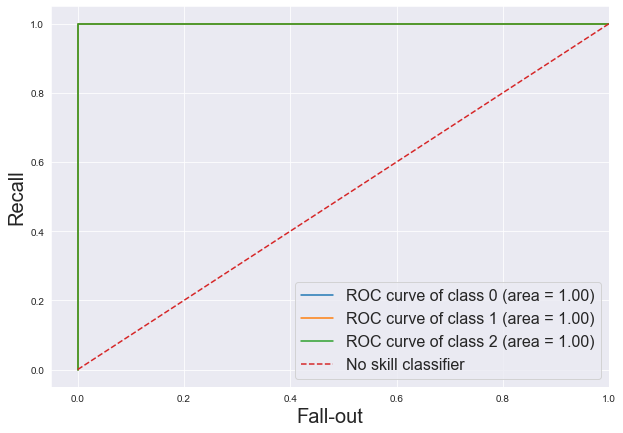

In [76]:
onefunctiontoplothemall(gscv.predict(X_test),y_test,"roc")

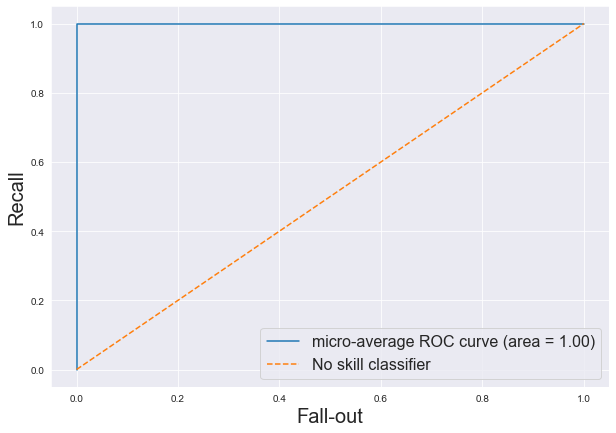

In [77]:
onefunctiontoplothemall(gscv.predict(X_test),y_test,"microavg_roc")

We are almost end of the LogisticRegression notebooks. I would like to talk about some cross validation functions that are originated from the ones that we used in this notebook. I will not use them here but I recommend you to do that. I will be probably using them in the upcoming notebooks.

1. RepeatedStratifiedKFold: This function is the combination of RepeatedKFold and StratifiedKFold. It performs RepeatedKFold algorithm and make sures that the folds are representative of the general population. Check out the [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RepeatedStratifiedKFold.html)
2. LeavePOut: We saw that the funtion `LeaveOneOut()` leave out one instance for test set in each iteration. On the other hand, LeavePOut leaves P number of instance for test dataset in each iteration. This function doesn't create non-overlapping folds unlike LeaveOneOut. Check the [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.LeaveOneOut.html)

Lastly, check the user guide of sklearn for Cross Validation functions. There are some functions that I didn't show such as `GroupKFold()` (It makes sures that instance in testing and training folds are different as well as all the test folds are different from each other). I do recommend checking the [documentation](https://scikit-learn.org/stable/modules/cross_validation.html)